# Annotating Cell Types

This workbook can be run after the standard workflow.
It is demonstrating how to use the  annotation function to annotate the dataset that was runned through the standard worflow.

In this notebook, we will show how to use in-besca annotation to assign cell type to clusters.
We focus on immune celltype and demonstrate signature-scoring functions.


An alternative in the case a an annotated training dataset already exists is to use the auto-annot module. Please refer to the corresponding tutorial.

In [ ]:
import besca as bc
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
from scipy import sparse, io
import os
import time
import logging
import seaborn as sns
sc.logging.print_versions()

# for standard processing, set verbosity to minimum
sc.settings.verbosity = 0  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80)
version = '2.8'
start0 = time.time()

In [2]:
### Plot parameters for publication 
def set_pub():    
    small_size = 10
    medium_size = 12
    large_size = 14

    resolution = 300 #in dpi
    plt.rcParams['font.weight'] = 'normal'
    #plt.rc('font', **{'family':'sans-serif','sans-serif':['Helvetica']})
    plt.rc('axes', titlesize=large_size, titleweight = "bold")               # fontsize of the axes title
    plt.rc('axes', labelsize=medium_size, labelweight = "bold")               # fontsize of the x and y labels
    plt.rc('xtick', labelsize=small_size)               # fontsize of the tick labels
    plt.rc('ytick', labelsize=small_size)               # fontsize of the tick labels
    plt.rc('legend', fontsize=small_size, title_fontsize = medium_size)               # legend fontsize
    plt.rc('figure', titlesize=large_size, titleweight = "bold")              # fontsize of the figure title
    plt.rc('savefig', dpi=resolution)                   # higher res outputs

    plt.rcParams['svg.fonttype'] = 'none'


set_pub()

In [3]:
#define standardized filepaths based on above input
root_path = os.getcwd()
bescapath_full = os.path.dirname(bc.__file__)
bescapath = os.path.split(bescapath_full)[0]

### Uncomment this when running after the sworflow
analysis_name = 'sw_besca2_bescapub'
results_folder = os.path.join(root_path, 'analyzed', analysis_name)
results_file = os.path.join(results_folder, analysis_name + '.annotated.updated.h5ad')
figdir=os.path.join(root_path, 'analyzed', analysis_name+'/figures/')
sc.settings.figdir = figdir
clusters='leiden'

In [4]:
adata = sc.read_h5ad(os.path.join(results_folder, analysis_name + '.h5ad') )
#adata = bc.datasets.Lee2020_processed() #alternative:
adata


AnnData object with n_obs × n_vars = 61370 × 2192
    obs: 'CELL', 'CONDITION', 'Patient', 'Tissue', 'Sample', 'Cell_type', 'Cell_subtype', 'percent_mito', 'n_counts', 'n_genes', 'leiden', 'celltype0', 'celltype1', 'celltype2', 'celltype3', 'dblabel'
    var: 'ENSEMBL', 'SYMBOL', 'n_cells', 'total_counts', 'frac_reads'
    uns: 'celltype0_colors', 'celltype1_colors', 'celltype2_colors', 'celltype3_colors', 'leiden', 'neighbors', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

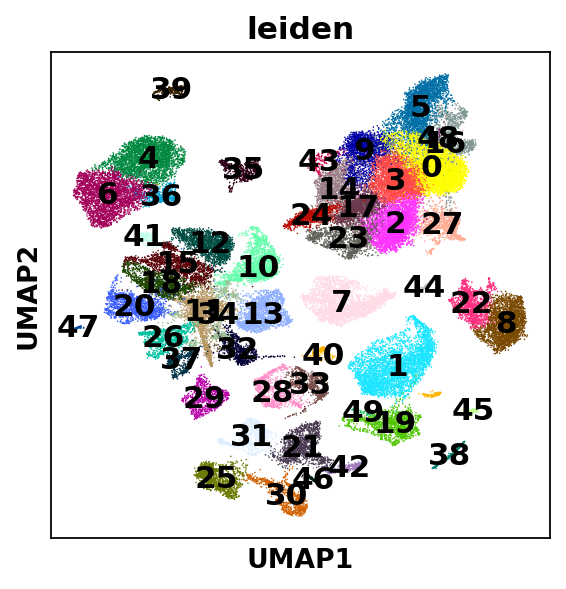

In [63]:
sc.pl.umap(adata, color= [clusters], legend_loc='on data', save='_leiden.svg')

### Inspect available public annotation

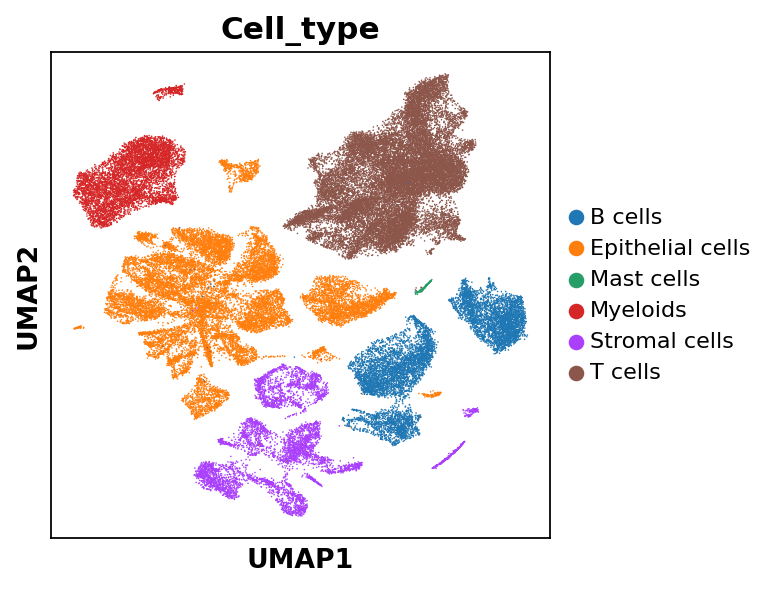

In [6]:
#sc.pl.umap(adata, color= ['Cell_type'])

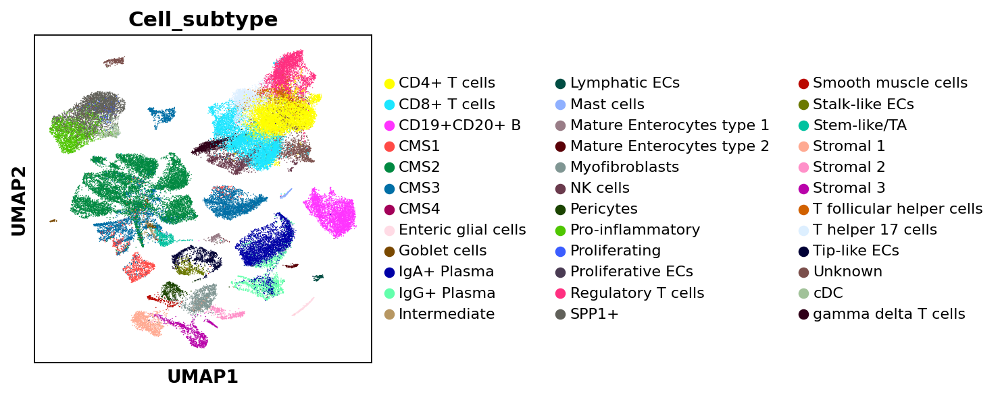

In [65]:
sc.pl.umap(adata, color= ['Cell_subtype'], save='_origlabel.svg')

#### If one trusts this annotation, one can obtain top markers per annotation & use to refine the signatures



In [7]:
### Perform DE cells of each celltype3 vs. all other cells
DEgenes=bc.tl.dge.get_de(adata,'Cell_subtype',demethod='wilcoxon',topnr=5000, logfc=1,padj=0.05)


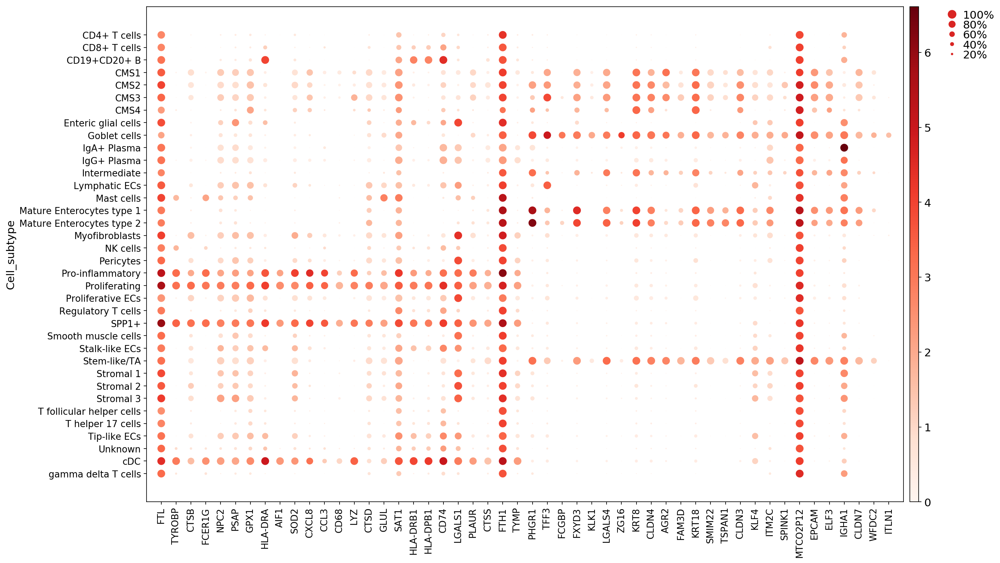

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[17.5, 0, 0.2, 0.5, 0.25])

In [26]:
### Select only top genes (in order of p-val) for 2 cell types and plot expression per cell type
tops=list(DEgenes['SPP1+']['Name'][0:25])+list(DEgenes['Goblet cells']['Name'][0:25])
sc.pl.dotplot(adata, var_names=tops,groupby='Cell_subtype')

In [42]:
myg=['TFF1','S100P','BCAS1','FCGBP','KLK1','ZG16']

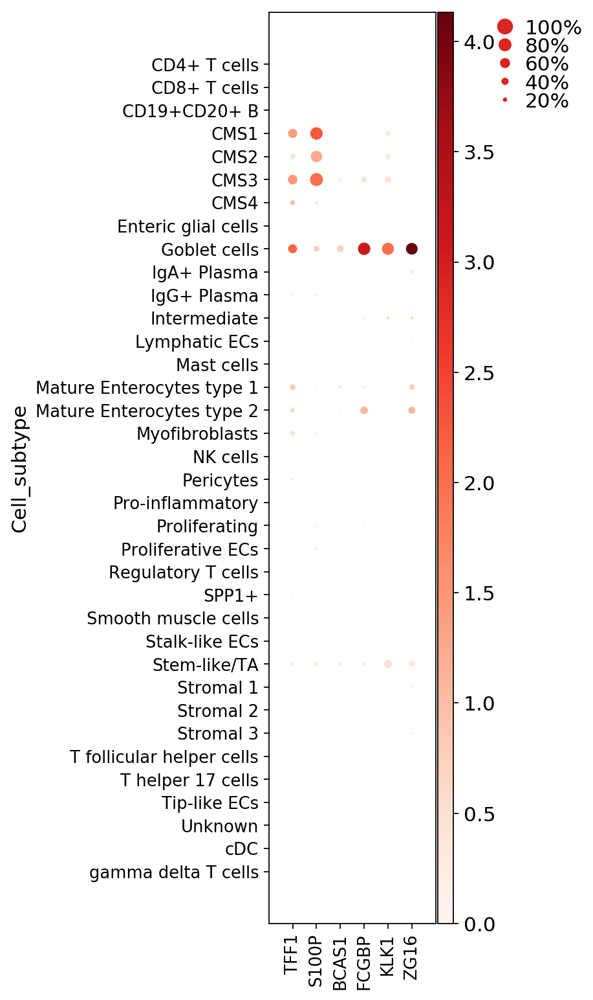

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[2.0999999999999996, 0, 0.2, 0.5, 0.25])

In [43]:
sc.pl.dotplot(adata, var_names=myg,groupby='Cell_subtype')

### Inspect various signatures

In [9]:
# One can load besca-provided signatures using the function below
signature_dict = bc.datasets.load_immune_signatures(refined=False)

signature_dict

{'lymphocyte': ['PTPRC'],
 'myeloid': ['S100A8', 'S100A9', 'CST3'],
 'Bcell': ['CD19', 'CD79A', 'MS4A1'],
 'Tcells': ['CD3E', 'CD3G', 'CD3D'],
 'CD4': ['CD4'],
 'CD8': ['CD8A', 'CD8B'],
 'NKcell': ['NKG7', 'GNLY', 'NCAM1'],
 'monocyte': ['CST3', 'CSF1R', 'ITGAM', 'CD14', 'FCGR3A', 'FCGR3B'],
 'macrophage': ['CD14',
  'IL1B',
  'LYZ    CD163   ITGAX',
  'CD68',
  'CSF1R',
  'FCGR3A']}

Additionaly it is possible to read an compute scanpy score using this function below.

If the gmt file is composed of combined signature (UP and DN), a common score will be computed: 
$$Total\_SCORE= Score_{UP} - Score_{DN}$$

In [10]:

gmt_file= bescapath + '/besca/datasets/genesets/Immune.gmt'
bc.tl.sig.combined_signature_score(adata, gmt_file,
                             UP_suffix='_UP', DN_suffix='_DN', method='scanpy',
                             overwrite=False, verbose=False,
                             use_raw=True, conversion=None)

In [11]:
scores = [x for x in adata.obs.columns if 'scanpy' in x]

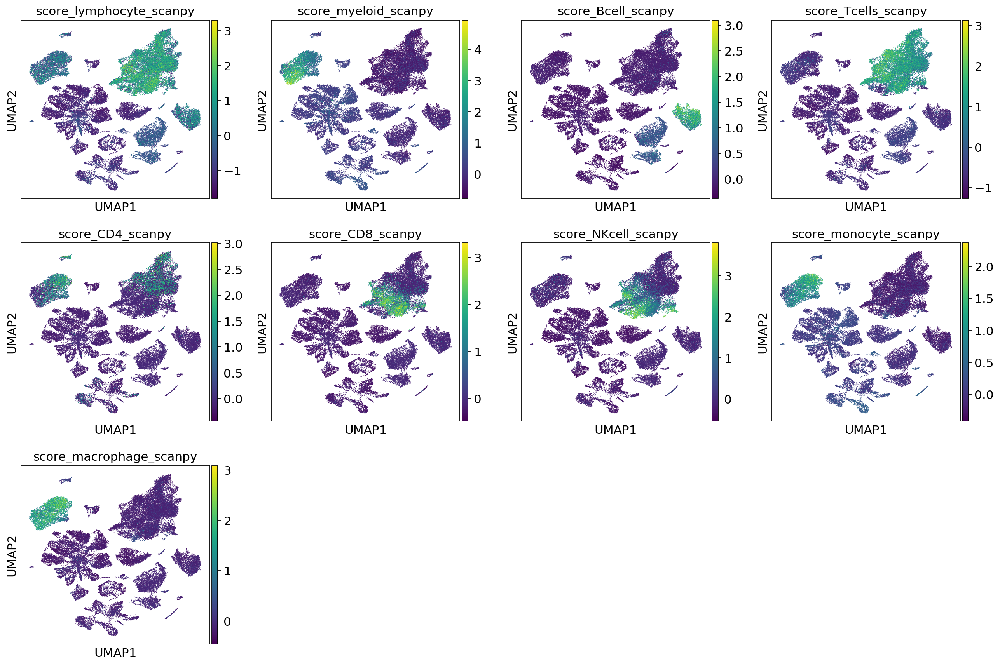

In [12]:
sc.pl.umap(adata, color= scores)

# Immune signatures for specific sub-populations

In [5]:
 ## PROVIDED WITH BESCA
gmt_file_anno= bescapath + '/besca/datasets/genesets/CellNames_scseqCMs6_sigs.gmt'
bc.tl.sig.combined_signature_score(adata, gmt_file_anno)


In [ ]:
scores = [x for x in adata.obs.columns if 'scanpy' in x]
sc.pl.umap(adata, color= scores, color_map = 'viridis', save='cellnames_sigs.pdf')

# Signature-based annotation

A decision-tree-based annotation that reads signatures from a provided .gmt file and hierarchy as well as cutoffs and signature ordering from a configuration file and attributes each cell to a specific type according to signature enrichment. 

This is an aid to start ther annotation and annotation can then be further refined by adding further signatures or adjusting the configuration files. It was tested mainly on PBMCs and oncology (tumor biopsies) related samples.


In [8]:
## PROVIDED WITH BESCA, make a local copy if you'd like to modify/add your own
gmt_file_anno= bescapath + '/besca/datasets/genesets/CellNames_scseqCMs6_sigs.gmt'
#gmt_file_anno= root_path + '/analyzed/'+analysis_name+ 'CellNames_scseqCMs6_sigs.gmt'

mymarkers = bc.tl.sig.read_GMT_sign(gmt_file_anno,directed=False)
mymarkers = bc.tl.sig.filter_siggenes(adata, mymarkers) ### remove genes not present in dataset or empty signatures
mymarkers['Ubi'] = ['B2M','ACTB', 'GAPDH'] ### used for cutoff adjustment to individual dataset, can be modified

We read the configuration file, containing hierarchy, cutoff and signature priority information. 
A new version of this file should be created and maintained with each annotation. 
The included example is optimised for the annotation of the PBMC and BM CITE-seq dataset. 

In [9]:
configfile= bescapath + '/besca/datasets/genesets/CellNames_scseqCMs6_config.tsv'
#configfile=root_path + '/analyzed/'+analysis_name+'/CellNames_scseqCMs6_config.tsv' ### replace this with your config

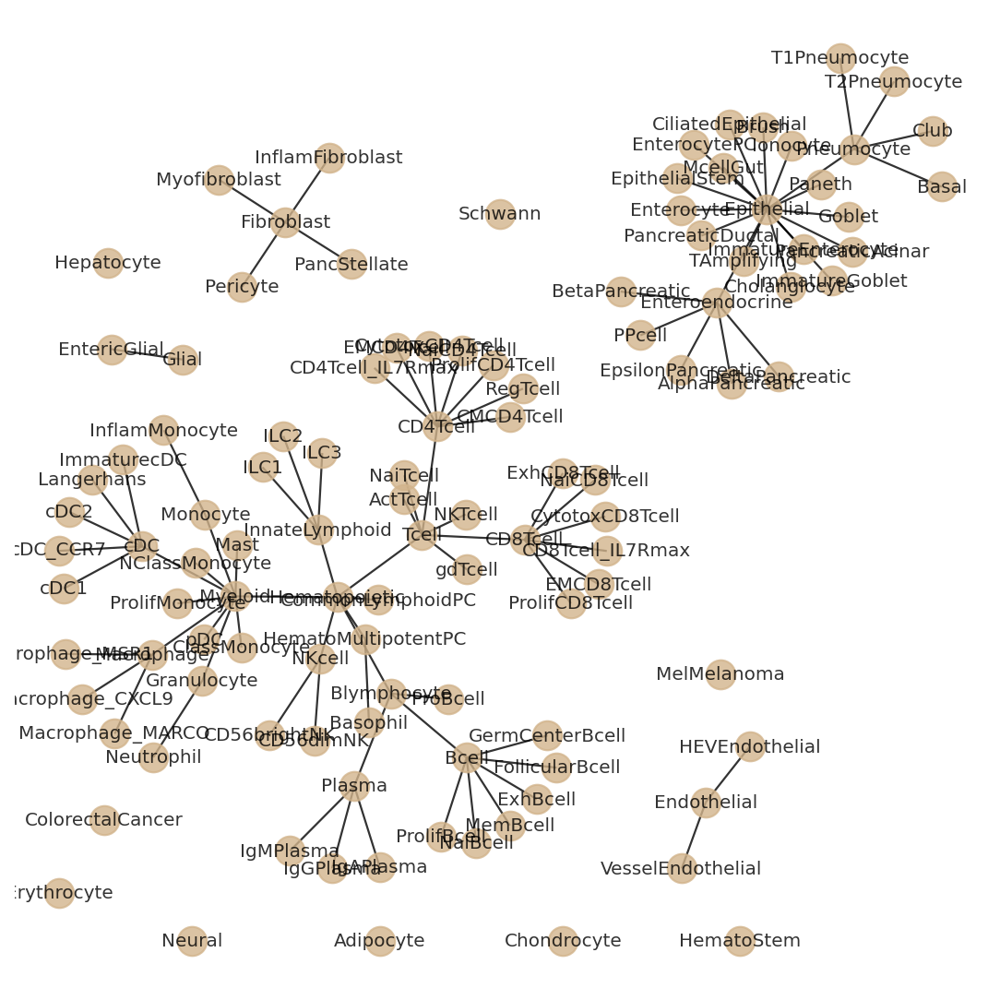

In [10]:
plt=bc.pl.nomenclature_network(configfile, font_size=9)


In [11]:
sigconfig,levsk=bc.tl.sig.read_annotconfig(configfile)

Fract_pos was exported by BESCA in the standard worflow test, 
contains information of fraction positive cells per genes per cluster.

We use these values as a basis for a wilcoxon test per signature per cluster. 

In [12]:
### change the order of CRC
levsk[0]=['ColorectalCancer',
 'Epithelial',
 'Fibroblast',
 'Endothelial',
 'Erythrocyte',
 'HematoStem',
 'Hepatocyte',
 'MelMelanoma',
 'Neural',
 'Adipocyte',
 'Hematopoietic',
 'Schwann',
 'Chondrocyte',
 'Glial']

In [13]:

f=pd.read_csv(results_folder + "/labelings/"+clusters+"/fract_pos.gct",sep="\t",skiprows=2)
df=bc.tl.sig.score_mw(f,mymarkers)
myc=np.median(df.loc['Ubi',:]*0.5) ### Set a cutoff based on Ubi and scale with values from config file


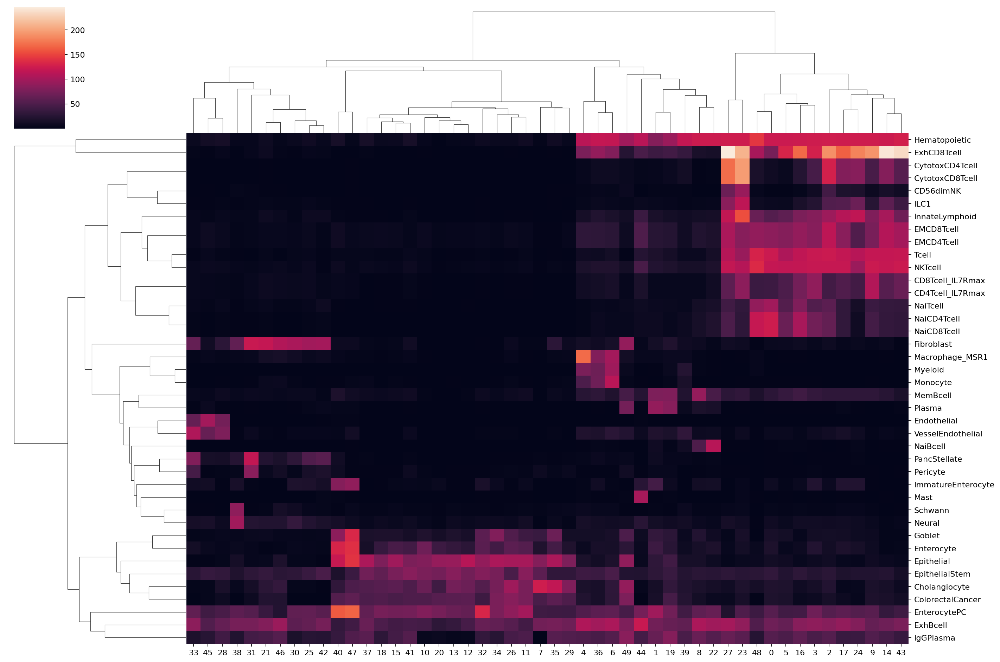

In [14]:
sns.clustermap(df.loc[df.max(axis=1)>myc*2.5,:].astype(float),figsize=(18, 12))
plt.savefig(figdir+"SignatureHeatmap_all.svg", format="svg")

For each signature, positive and negative clusters are determined. Only positive clusters are maintained. Cutoffs can be individualised based on the config file (scaling factor) and myc, which is determined based on ubiquitously expressed genes. 

In [15]:
df=df.drop('Ubi')

In [16]:
sigconfig.loc['Epithelial','Cutoff']=1.75
sigconfig.loc['Fibroblast','Cutoff']=2
sigconfig.loc['Endothelial','Cutoff']=1.5
sigconfig.loc['Tcell','Cutoff']=3
sigconfig.loc['ColorectalCancer','Cutoff']=1.75
sigconfig.loc['IgAPlasma','Cutoff']=1.5
sigconfig.loc['IgGPlasma','Cutoff']=2
sigconfig.loc['gdTcell','Cutoff']=1
sigconfig.loc['EMCD8Tcell','Cutoff']=3


In [17]:
#Cluster attribution based on cutoff
sigscores={}
for mysig in list(df.index):
    sigscores[mysig]=bc.tl.sig.getset(df,mysig,sigconfig.loc[mysig,'Cutoff']*myc)
    #sigscores[mysig]=bc.tl.sig.getset(df,mysig,10)

One can inspect the cluster attribution per cell type in the signature list and adjust cutoffs as required. 

In [18]:
#sigscores

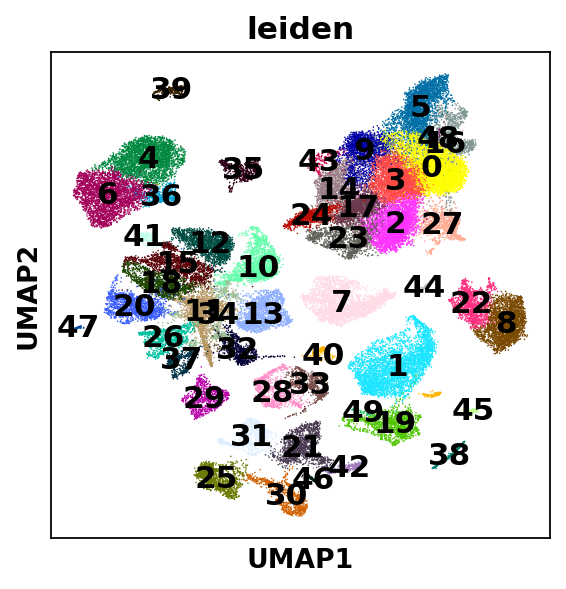

In [19]:
sc.pl.umap(adata, color= [clusters], legend_loc='on data')

Now each cluster gets annotated, according to the distinct levels specified in the config file. 
Note that in case a cluster is positive for multiple identities, only the first one is taken, 
in the order specified in the "Order" column in the config file. 

To check the given order, per levels, you can inspect levsk

In [20]:
toexclude=['Erythrocyte','AlphaPancreatic', 'BetaPancreatic', 'DeltaPancreatic', 'PPcell', 'PancreaticDuctal', 'PancreaticAcinar', 
           'EpsilonPancreatic', 'PancStellate', 'Neural','Chondrocyte','Langerhans','CommonLymphoidPC',
           'HematoMultipotentPC','Chondrocyte','ExhBcell','FollicularBcell','Cholangiocyte', 'Schwann']

In [21]:
cnames=bc.tl.sig.make_anno(df,sigscores,sigconfig,levsk,toexclude=toexclude)

In [22]:
cnames

,celltype0,celltype1,celltype2,celltype3
49,ColorectalCancer,ColorectalCancer,ColorectalCancer,ColorectalCancer
15,Epithelial,EnterocytePC,EnterocytePC,EnterocytePC
27,Hematopoietic,Tcell,CD8Tcell,CytotoxCD8Tcell
35,ColorectalCancer,ColorectalCancer,ColorectalCancer,ColorectalCancer
17,Hematopoietic,Tcell,CD8Tcell,ExhCD8Tcell
40,Epithelial,ImmatureEnterocyte,ImmatureEnterocyte,ImmatureEnterocyte
21,Fibroblast,Fibroblast,Fibroblast,Fibroblast
16,Hematopoietic,Tcell,CD4Tcell,RegTcell
2,Hematopoietic,Tcell,CD8Tcell,CytotoxCD8Tcell
29,Epithelial,Epithelial,Epithelial,Epithelial


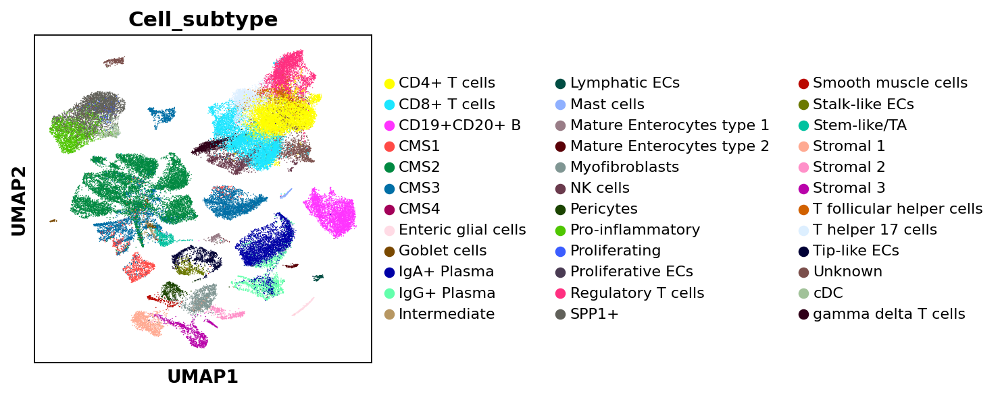

In [23]:
sc.pl.umap(adata,color=['Cell_subtype']) 

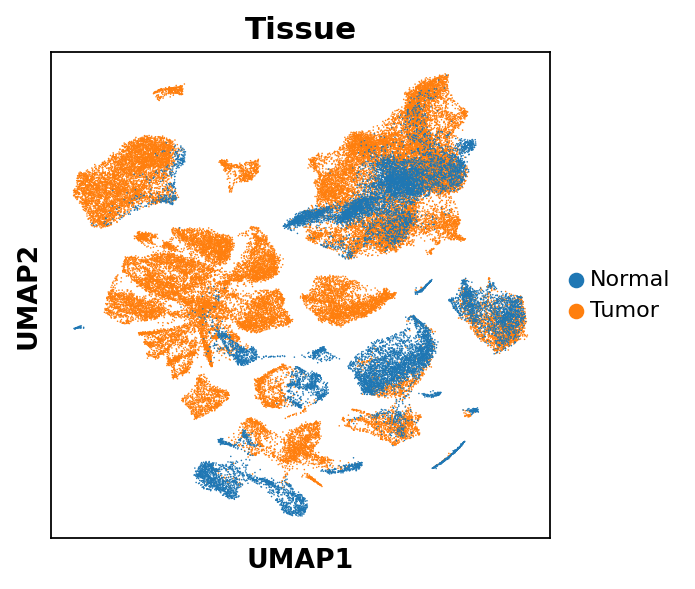

In [66]:
sc.pl.umap(adata,color=['Tissue'], save='_TumorNormal.svg') 

We now obtained per each cluster cell type attribution at distinct levels. 

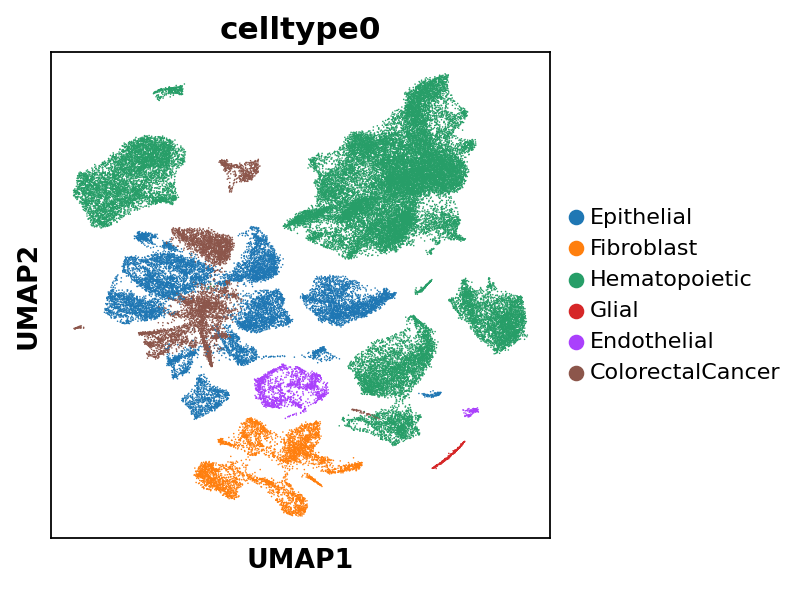

In [141]:
adata.obs['celltype0']=bc.tl.sig.add_anno(adata,cnames,'celltype0',clusters)
adata.obs['celltype1']=bc.tl.sig.add_anno(adata,cnames,'celltype1',clusters)
adata.obs['celltype2']=bc.tl.sig.add_anno(adata,cnames,'celltype2',clusters)
adata.obs['celltype3']=bc.tl.sig.add_anno(adata,cnames,'celltype3',clusters)

sc.pl.umap(adata,color=['celltype0']) #,'celltype3'

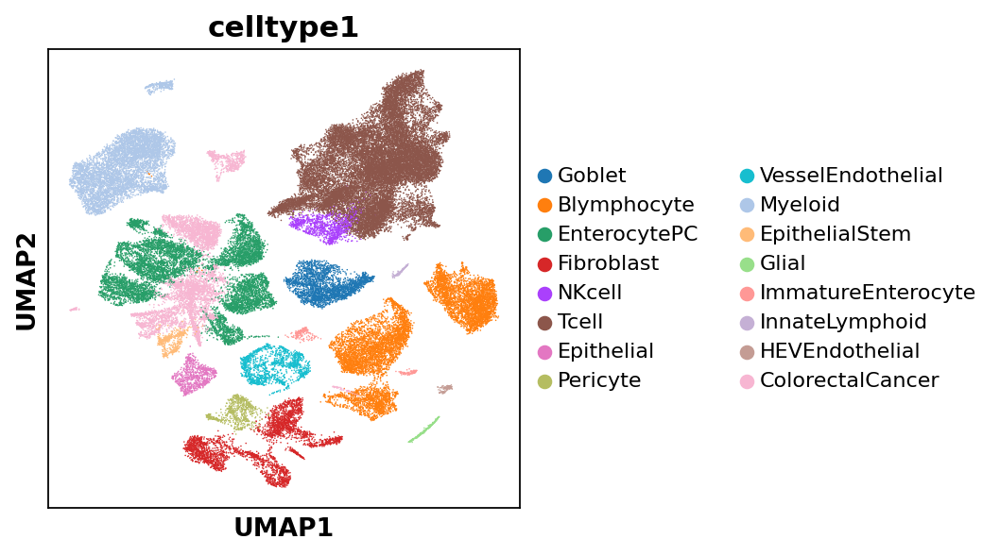

In [142]:
sc.pl.umap(adata,color=['celltype1']) #,'celltype3'

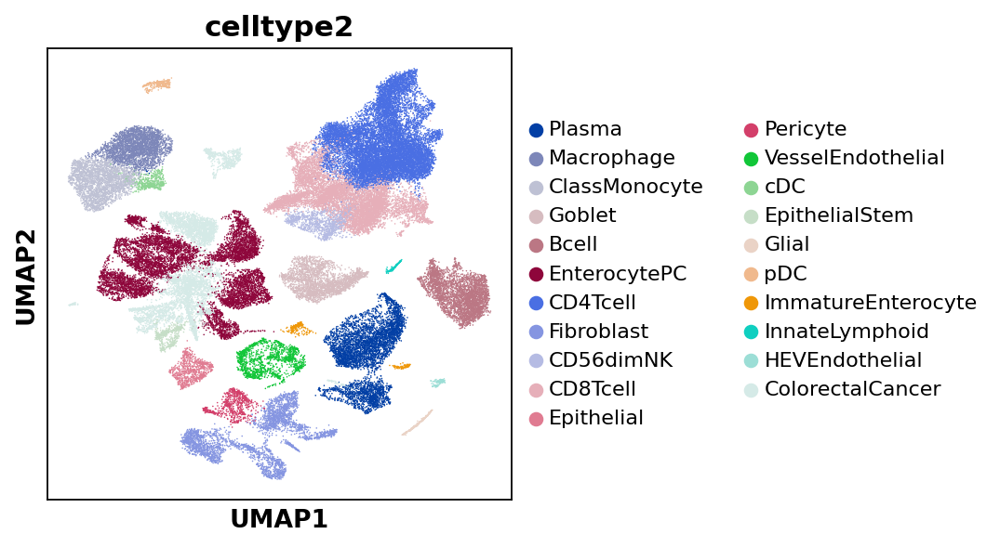

In [143]:
sc.pl.umap(adata,color=['celltype2']) #,'celltype3'

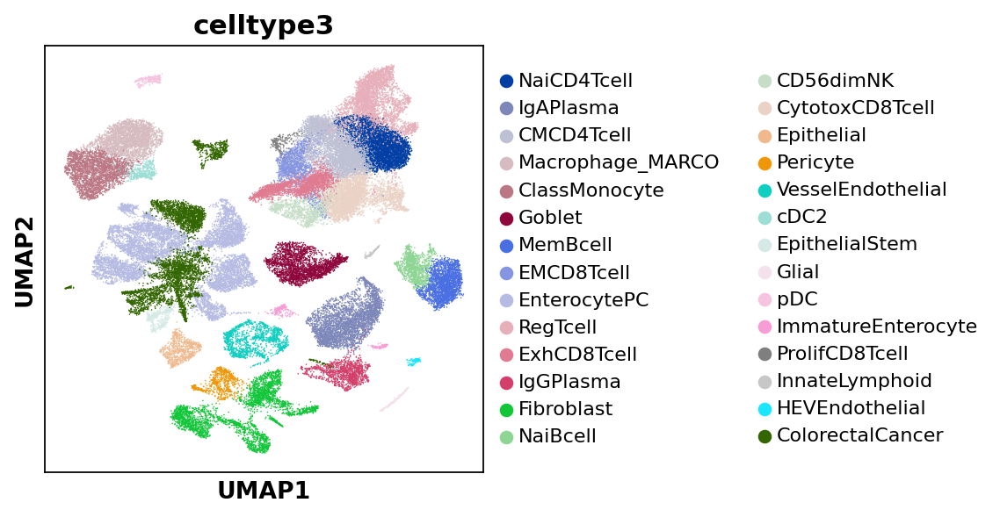

In [144]:
sc.pl.umap(adata,color=['celltype3']) #,'celltype3'

Only short names were used in the signature naming convention in this case. 
One can easity tranform this to EFO terms if preferred, a conversion table comes with besca. 

In [145]:
### transform these short forms to dblabel - EFO standard nomenclature
nomenclature=pd.read_csv(bescapath+'/besca/datasets/nomenclature/CellTypes_v1.tsv',sep='\t',header=0,skiprows=range(1, 2))
#tmp=nomenclature.loc[0,:].copy(); tmp[0]=tmp[1]="unknown"; tmp[2]="NCL:0001"; tmp[3]="Unknown"
#nomenclature=nomenclature.append(tmp)

cnamesDBlabel=[]
for mycol in list(cnames.columns):
    cnamesDBlabel.append([list(nomenclature.loc[nomenclature['short_dblabel']==x,'dblabel'])[0] for x in list(cnames[mycol])])
cnamesDBlabel=pd.DataFrame(cnamesDBlabel).transpose()
cnamesDBlabel.columns=cnames.columns
cnamesDBlabel.index=cnames.index

Finally, one can add the new labels to adata.obs as annotation. 

In [146]:
adata.obs['celltype0']=bc.tl.sig.add_anno(adata,cnamesDBlabel,'celltype0',clusters)
adata.obs['celltype1']=bc.tl.sig.add_anno(adata,cnamesDBlabel,'celltype1',clusters)
adata.obs['celltype2']=bc.tl.sig.add_anno(adata,cnamesDBlabel,'celltype2',clusters)
adata.obs['celltype3']=bc.tl.sig.add_anno(adata,cnamesDBlabel,'celltype3',clusters)

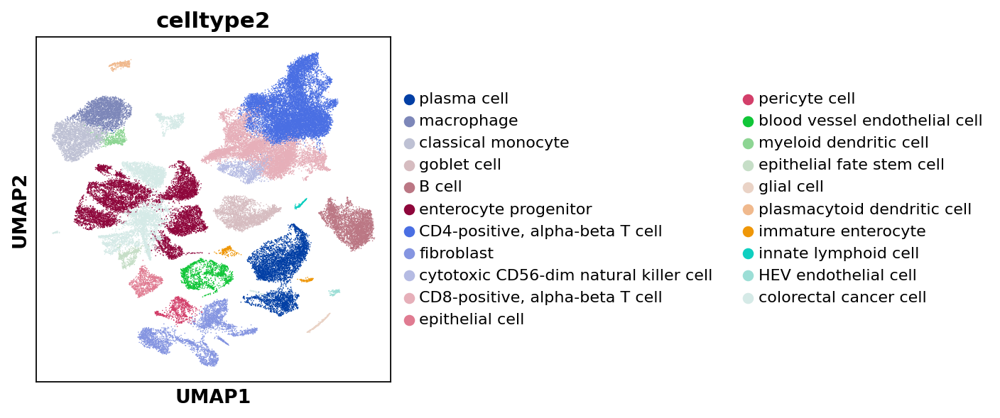

In [147]:
sc.pl.umap(adata,color=['celltype2']) #,'celltype3'

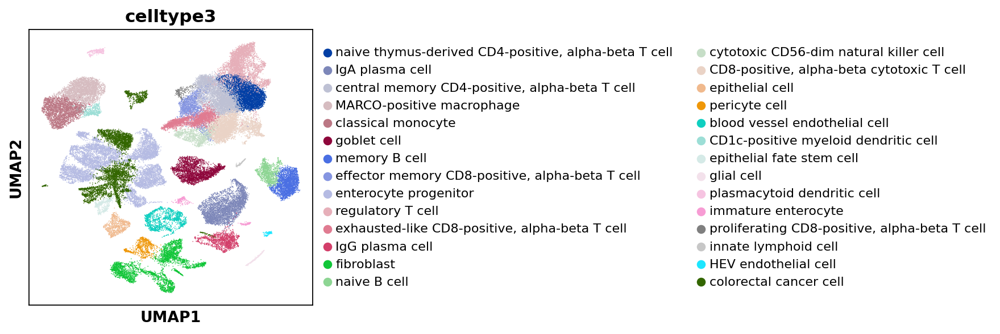

In [148]:
sc.pl.umap(adata,color=['celltype3']) #,'celltype3'

In [149]:
### Which classification has cluster 7? 
bc.tl.sig.match_cluster(adata,'leiden','12','celltype3',0.3)

['colorectal cancer cell']

In [150]:
### What cluster corresponds to neutrophils? 
bc.tl.sig.match_cluster(adata,'celltype3','neutrophil','leiden',0.3) ## lowered cutoff

[]

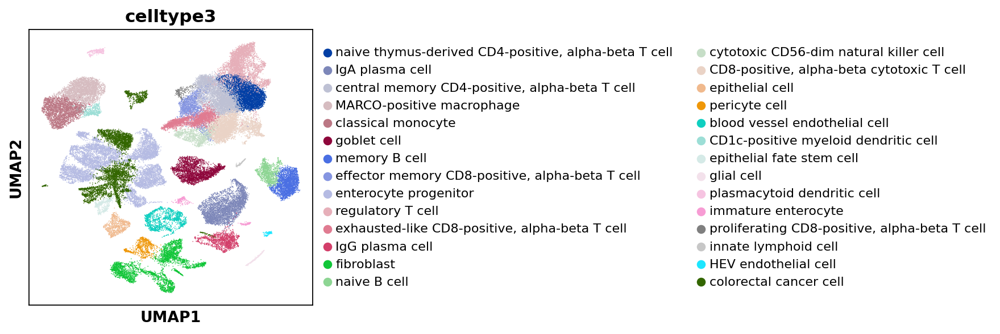

In [151]:
sc.pl.umap(adata,color=['celltype3']) #,'celltype3'

In [152]:
### Manually modify individual cluster labels if still required: CANCER CELLS
cancerclusters=['enterocyte progenitor','epithelial cell','epithelial fate stem cell','goblet cell']
adata.obs.loc[adata.obs['celltype3'].isin(cancerclusters),'celltype0']='colorectal cancer cell'
adata.obs['celltype3']=list(adata.obs['celltype3'].replace(cancerclusters, 'colorectal cancer cell'))
adata.obs['celltype2']=list(adata.obs['celltype2'].replace(cancerclusters, 'colorectal cancer cell'))
adata.obs['celltype1']=list(adata.obs['celltype1'].replace(cancerclusters, 'colorectal cancer cell'))


In [153]:
### ENTEROCYTES
adata.obs['celltype3']=list(adata.obs['celltype3'].replace('immature enterocyte', 'enterocyte'))
adata.obs['celltype2']=list(adata.obs['celltype2'].replace('immature enterocyte', 'enterocyte'))
adata.obs['celltype1']=list(adata.obs['celltype1'].replace('immature enterocyte', 'enterocyte'))


### Manually modify individual cluster labels if still required: MAST CELLS not recognised as myeloids
adata.obs.loc[adata.obs['celltype3']=='innate lymphoid cell','celltype1']='myeloid leukocyte'
adata.obs['celltype2']=list(adata.obs['celltype2'].replace('innate lymphoid cell', 'mast cell'))
adata.obs['celltype3']=list(adata.obs['celltype3'].replace('innate lymphoid cell', 'mast cell'))

... storing 'celltype1' as categorical
... storing 'celltype2' as categorical
... storing 'celltype3' as categorical


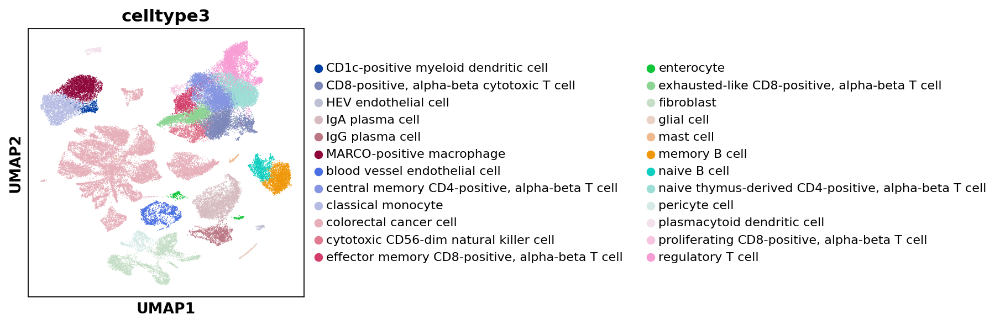

In [154]:
sc.pl.umap(adata,color=['celltype3'], save='_celltype3.svg') #,'celltype3'

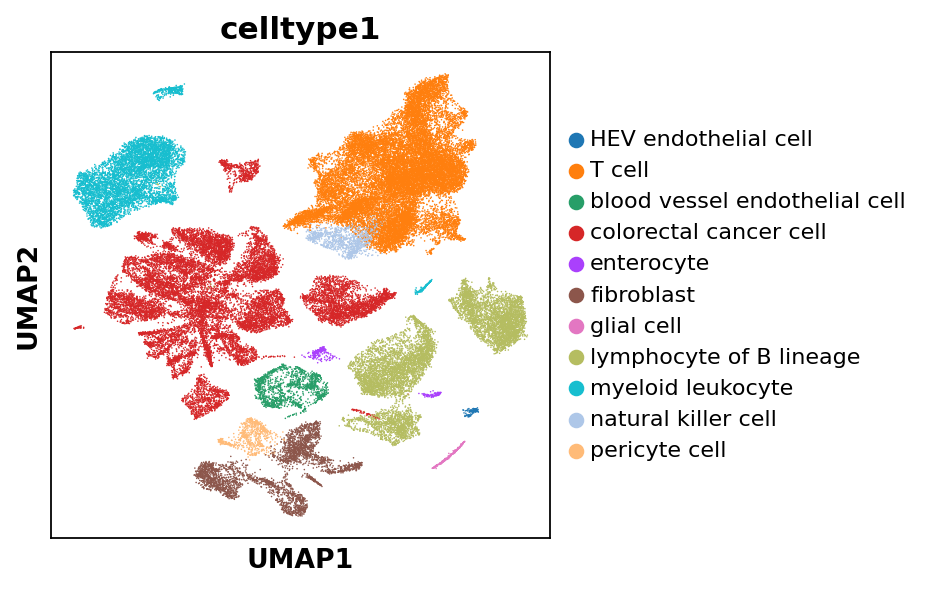

In [155]:
sc.pl.umap(adata,color=['celltype1'], save='_celltype1.svg') #,'celltype3'

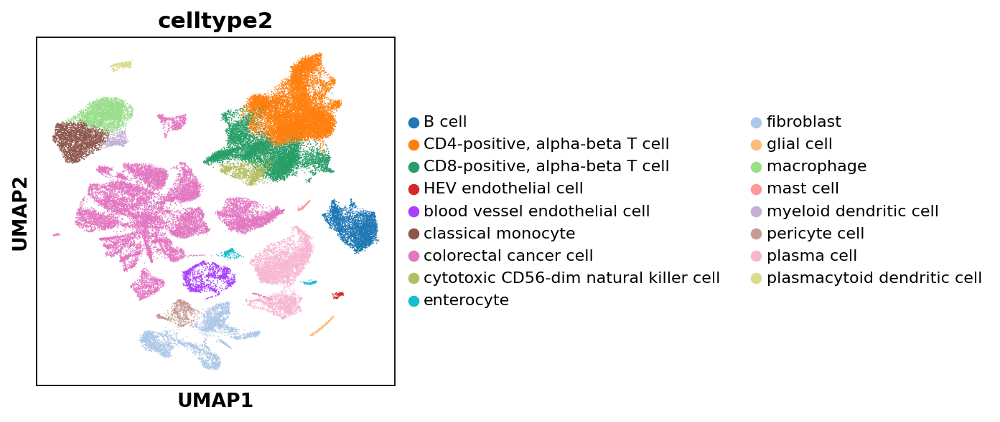

In [156]:
sc.pl.umap(adata,color=['celltype2'], save='_celltype2.svg')

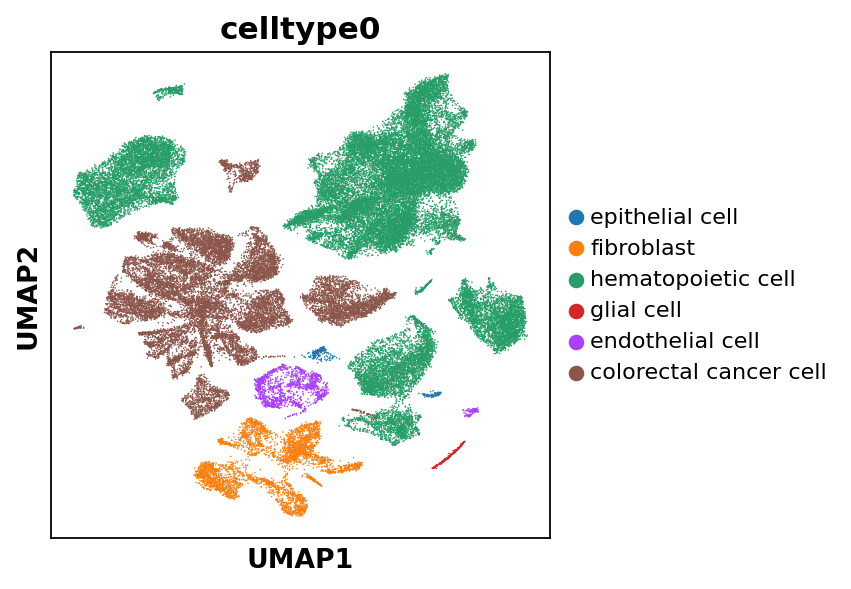

In [157]:
sc.pl.umap(adata,color=['celltype0'], save='_celltype0.svg')

In [158]:
### dblabel
adata.obs['dblabel']=adata.obs['celltype3']

In [159]:
### Save annotated file for future reference
adata.write(results_file)

### Export labelling

Chosen labels can also be exported as a new folder in labelings/

In [ ]:
### Save labelling
adata = bc.st.additional_labeling(adata, 'celltype0', 'celltype0', 'Major cell types attributed based on HumanCD45p_scseqCMs8', 'author', results_folder)


In [ ]:
### Save labelling
adata = bc.st.additional_labeling(adata, 'dblabel', 'dblabel', 'Cell types attributed according to EFO nomenclature', 'author', results_folder)


### Obtain top marker genes per cluster - for future studies

In [161]:
### Perform DE cells of each celltype3 vs. all other cells
DEgenes=bc.tl.dge.get_de(adata,'celltype3',demethod='wilcoxon',topnr=5000, logfc=1,padj=0.05)

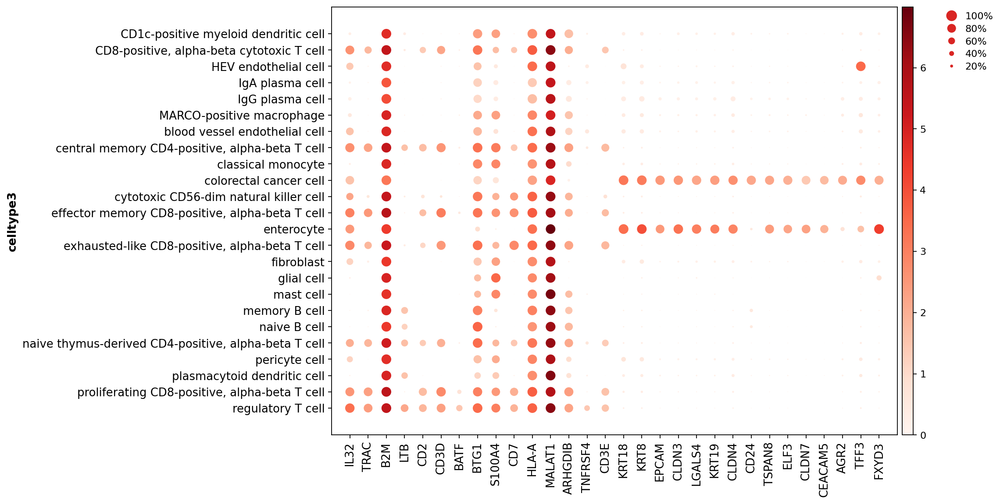

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[10.5, 0, 0.2, 0.5, 0.25])

In [162]:
### Select only top 15 genes (in order of p-val) for 2 cell types and plot expression per cell type
tops=list(DEgenes['regulatory T cell']['Name'][0:15])+list(DEgenes['colorectal cancer cell']['Name'][0:15])
sc.pl.dotplot(adata, var_names=tops,groupby='celltype3')

In [163]:
### add second marker method

### Check further genes similarly distributed as markers of interest

In [47]:
import scipy.stats as ss
allmarkers=adata.var_names

# In[101]:
spearcorsAll = {}
for i in allmarkers:
    spearcorsAll[i]=ss.spearmanr(adata.raw[:, i].X,adata.raw[:,'GZMK'].X)[0]
# In[103]:
import operator
spearcorsAll=sorted(spearcorsAll.items(),key=operator.itemgetter(1))
spearcorsAll_ids = [idx for idx, val in spearcorsAll]
goiPosAll=spearcorsAll_ids[0:30]
goiNegAll=spearcorsAll_ids[(len(spearcorsAll_ids)-30):len(spearcorsAll_ids)]

In [164]:
#sc.pl.dotplot(adata, var_names=goiPosAll,groupby='celltype3',dot_max=0.5)

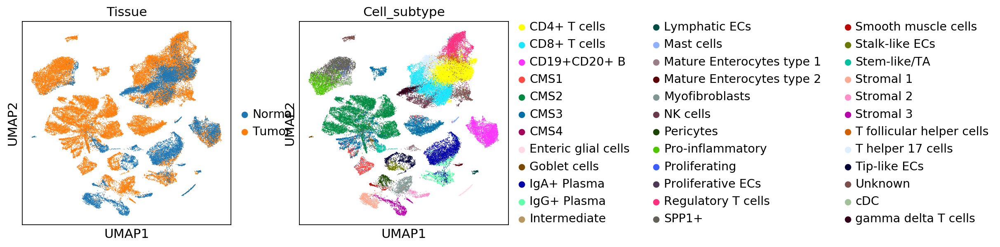

In [11]:
sc.pl.umap(adata,color=['Tissue','Cell_subtype'])

### Compare annotation


In [7]:
set(adata.obs['Cell_type'])


{'B cells',
 'Epithelial cells',
 'Mast cells',
 'Myeloids',
 'Stromal cells',
 'T cells'}

In [38]:
dblabel_trans={}
dblabel_trans['B cells']='lymphocyte of B lineage'
dblabel_trans['Epithelial cells']='epithelial cell'
dblabel_trans['Mast cells']='myeloid leukocyte'
dblabel_trans['Myeloids']='myeloid leukocyte'
dblabel_trans['Stromal cells']='fibroblast'
dblabel_trans['Fibroblast cell']='fibroblast'
dblabel_trans['T cells']='T cell'

In [24]:
set(adata.obs['Cell_subtype'])


{'CD19+CD20+ B',
 'CD4+ T cells',
 'CD8+ T cells',
 'CMS1',
 'CMS2',
 'CMS3',
 'CMS4',
 'Enteric glial cells',
 'Goblet cells',
 'IgA+ Plasma',
 'IgG+ Plasma',
 'Intermediate',
 'Lymphatic ECs',
 'Mast cells',
 'Mature Enterocytes type 1',
 'Mature Enterocytes type 2',
 'Myofibroblasts',
 'NK cells',
 'Pericytes',
 'Pro-inflammatory',
 'Proliferating',
 'Proliferative ECs',
 'Regulatory T cells',
 'SPP1+',
 'Smooth muscle cells',
 'Stalk-like ECs',
 'Stem-like/TA',
 'Stromal 1',
 'Stromal 2',
 'Stromal 3',
 'T follicular helper cells',
 'T helper 17 cells',
 'Tip-like ECs',
 'Unknown',
 'cDC',
 'gamma delta T cells'}

In [37]:
set(adata.obs['celltype1'])


{'HEV endothelial cell',
 'T cell',
 'blood vessel endothelial cell',
 'colorectal cancer cell',
 'enterocyte',
 'fibroblast',
 'glial cell',
 'lymphocyte of B lineage',
 'myeloid leukocyte',
 'natural killer cell',
 'pericyte cell'}

In [26]:
dblabel_trans2={}
dblabel_trans2['CD19+CD20+ B']='B cell'
dblabel_trans2['CD4+ T cells']='CD4-positive, alpha-beta T cell'
dblabel_trans2['CD8+ T cells']='CD8-positive, alpha-beta T cell'
dblabel_trans2['CMS1']='colorectal cancer cell'
dblabel_trans2['CMS2']='colorectal cancer cell'
dblabel_trans2['CMS3']='colorectal cancer cell'
dblabel_trans2['CMS4']='colorectal cancer cell'
dblabel_trans2['Enteric glial cells']='glial cell'
dblabel_trans2['Goblet cells']='goblet cell'
dblabel_trans2['IgA+ Plasma']='plasma cell'
dblabel_trans2['IgG+ Plasma']='plasma cell'
dblabel_trans2['Intermediate']='colorectal cancer cell'
dblabel_trans2['Lymphatic ECs']='endothelial cell of lymphatic vessel'
dblabel_trans2['Mast cells']='mast cell'
dblabel_trans2['Mature Enterocytes type 1']='enterocyte'
dblabel_trans2['Mature Enterocytes type 2']='enterocyte'
dblabel_trans2['Myofibroblasts']='myofibroblast'
dblabel_trans2['NK cells']='natural killer cell'
dblabel_trans2['Pericytes']='pericyte cell'
dblabel_trans2['Pro-inflammatory']='classical monocyte'
dblabel_trans2['Proliferating']='proliferating myeloid leukocyte'
dblabel_trans2['Proliferative ECs']='endothelial cell'
dblabel_trans2['Regulatory T cells']='regulatory T cell'
dblabel_trans2['SPP1+']='macrophage'
dblabel_trans2['Smooth muscle cells']='smooth muscle cell'
dblabel_trans2['Stalk-like ECs']='endothelial stalk cell'
dblabel_trans2['Stem-like/TA']='transit amplifying cell'
dblabel_trans2['Stromal 1']='fibroblast'
dblabel_trans2['Stromal 2']='fibroblast'
dblabel_trans2['Stromal 3']='fibroblast'
dblabel_trans2['T follicular helper cells']='CD4-positive, alpha-beta T cell'
dblabel_trans2['T helper 17 cells']='T-helper 17 cell'
dblabel_trans2['Tip-like ECs']='endothelial tip cell'
dblabel_trans2['Unknown']='animal cell'
dblabel_trans2['cDC']='myeloid dendritic cell'
dblabel_trans2['gamma delta T cells']='gamma delta T cell'


In [27]:

dblabel_trans3={}
dblabel_trans3['CD19+CD20+ B']='B cell'
dblabel_trans3['CD4+ T cells']='CD4-positive, alpha-beta T cell'
dblabel_trans3['CD8+ T cells']='CD8-positive, alpha-beta T cell'
dblabel_trans3['CMS1']='colorectal cancer cell'
dblabel_trans3['CMS2']='colorectal cancer cell'
dblabel_trans3['CMS3']='colorectal cancer cell'
dblabel_trans3['CMS4']='colorectal cancer cell'
dblabel_trans3['Enteric glial cells']='glial cell'
dblabel_trans3['Goblet cells']='goblet cell'
dblabel_trans3['IgA+ Plasma']='IgA plasma cell'
dblabel_trans3['IgG+ Plasma']='IgG plasma cell'
dblabel_trans3['Intermediate']='colorectal cancer cell'
dblabel_trans3['Lymphatic ECs']='endothelial cell of lymphatic vessel'
dblabel_trans3['Mast cells']='mast cell'
dblabel_trans3['Mature Enterocytes type 1']='enterocyte'
dblabel_trans3['Mature Enterocytes type 2']='enterocyte'
dblabel_trans3['Myofibroblasts']='myofibroblast cell'
dblabel_trans3['NK cells']='natural killer cell'
dblabel_trans3['Pericytes']='pericyte cell'
dblabel_trans3['Pro-inflammatory']='classical monocyte'
dblabel_trans3['Proliferating']='proliferating myeloid leukocyte'
dblabel_trans3['Proliferative ECs']='endothelial cell'
dblabel_trans3['Regulatory T cells']='regulatory T cell'
dblabel_trans3['SPP1+']='macrophage'
dblabel_trans3['Smooth muscle cells']='smooth muscle cell'
dblabel_trans3['Stalk-like ECs']='endothelial stalk cell'
dblabel_trans3['Stem-like/TA']='transit amplifying cell'
dblabel_trans3['Stromal 1']='fibroblast'
dblabel_trans3['Stromal 2']='fibroblast'
dblabel_trans3['Stromal 3']='fibroblast'
dblabel_trans3['T follicular helper cells']='CD4-positive helper T cell'
dblabel_trans3['T helper 17 cells']='T-helper 17 cell'
dblabel_trans3['Tip-like ECs']='endothelial tip cell'
dblabel_trans3['Unknown']='animal cell'
dblabel_trans3['cDC']='myeloid dendritic cell'
dblabel_trans3['gamma delta T cells']='gamma delta T cell'


In [28]:
pd.Series(dblabel_trans).loc[adata.obs['Cell_type']]


Epithelial cells      epithelial cell
Epithelial cells      epithelial cell
Epithelial cells      epithelial cell
Epithelial cells      epithelial cell
Epithelial cells      epithelial cell
                          ...        
Mast cells          myeloid leukocyte
Mast cells          myeloid leukocyte
Mast cells          myeloid leukocyte
Mast cells          myeloid leukocyte
Mast cells          myeloid leukocyte
Length: 61370, dtype: object

In [39]:
import random
random.seed(1)

adata.obs['Cell_type_dblabel']=list(pd.Series(dblabel_trans).loc[adata.obs['Cell_type']])
adata.obs['Cell_subtype_dblabel_lev2']=list(pd.Series(dblabel_trans2).loc[adata.obs['Cell_subtype']])
adata.obs['Cell_subtype_dblabel_lev3']=list(pd.Series(dblabel_trans3).loc[adata.obs['Cell_subtype']])


In [40]:
adata.obs['Cell_type_random']=list(adata.obs['Cell_type'].sample(frac=1))
adata.obs['Cell_subtype_random']=list(adata.obs['Cell_subtype'].sample(frac=1))

adata.obs['Cell_type_dblabel_random']=list(adata.obs['Cell_type_dblabel'].sample(frac=1))
adata.obs['Cell_subtype_dblabel_lev2_random']=list(adata.obs['Cell_subtype_dblabel_lev2'].sample(frac=1))
adata.obs['Cell_subtype_dblabel_lev3_random']=list(adata.obs['Cell_subtype_dblabel_lev3'].sample(frac=1))


acc: 0.0
f1: 0.0


... storing 'Cell_type_dblabel' as categorical
... storing 'Cell_subtype_dblabel_lev2' as categorical
... storing 'Cell_subtype_dblabel_lev3' as categorical
... storing 'Cell_type_random' as categorical
... storing 'Cell_subtype_random' as categorical
... storing 'Cell_type_dblabel_random' as categorical
... storing 'Cell_subtype_dblabel_lev2_random' as categorical
... storing 'Cell_subtype_dblabel_lev3_random' as categorical


ami: 0.75
ari: 0.54
silhouette Cell_subtype: 0.04
silhouette dblabel: 0.2
pair confusion matrix:
            0          1
0  3243189594  229782506
1    76495312  216748118


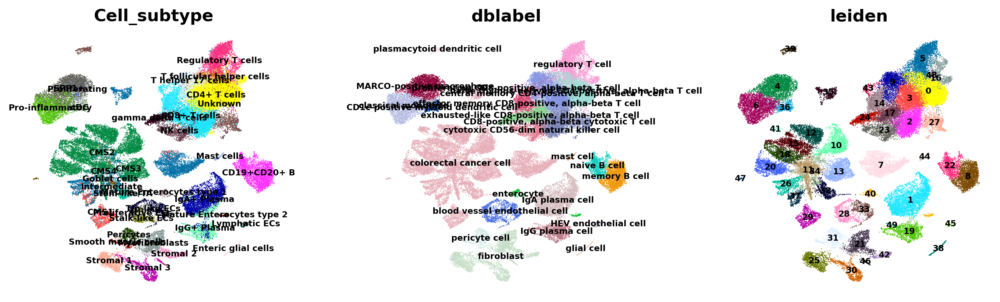

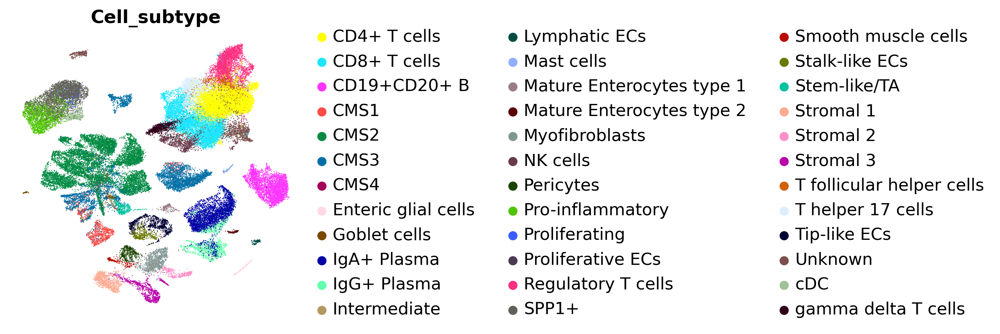

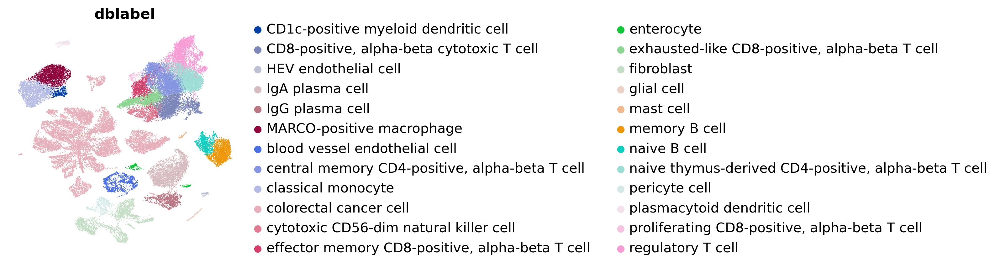

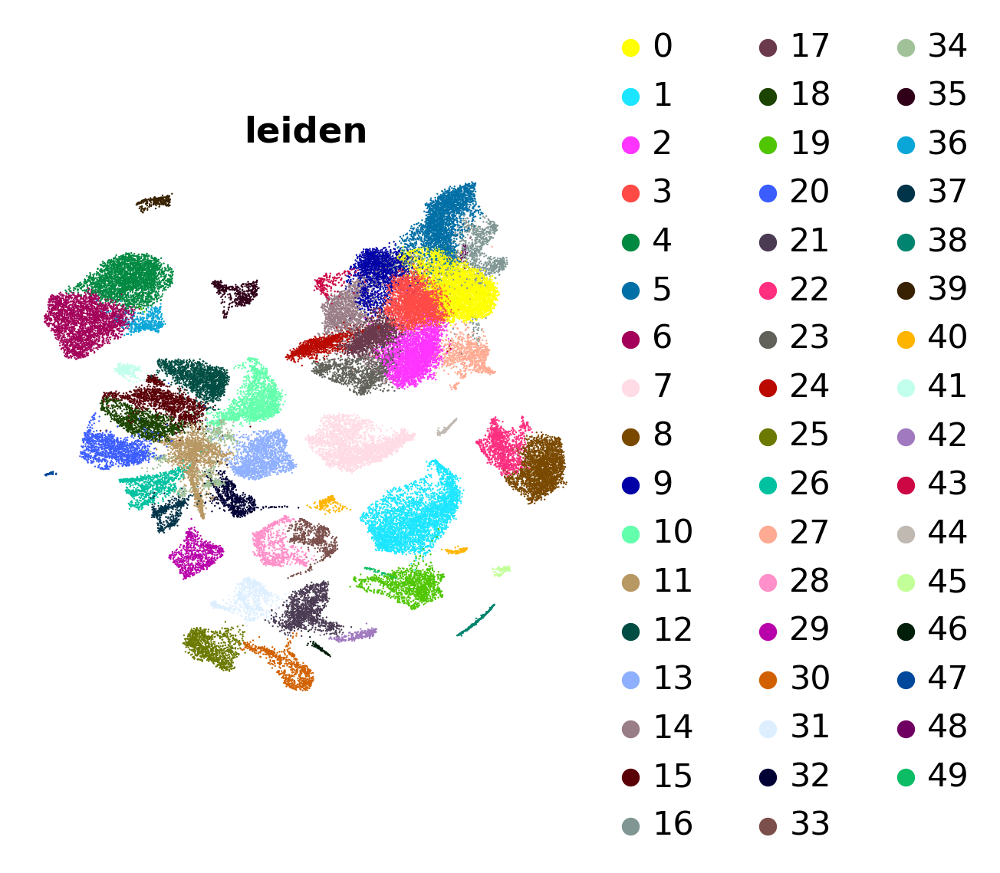

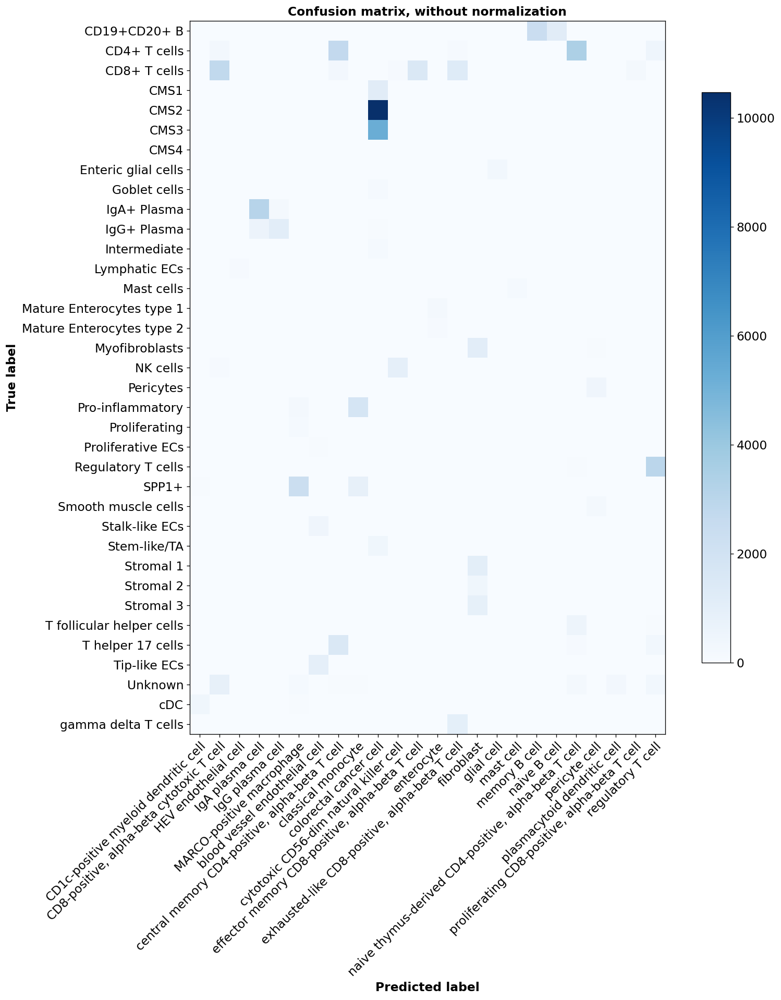

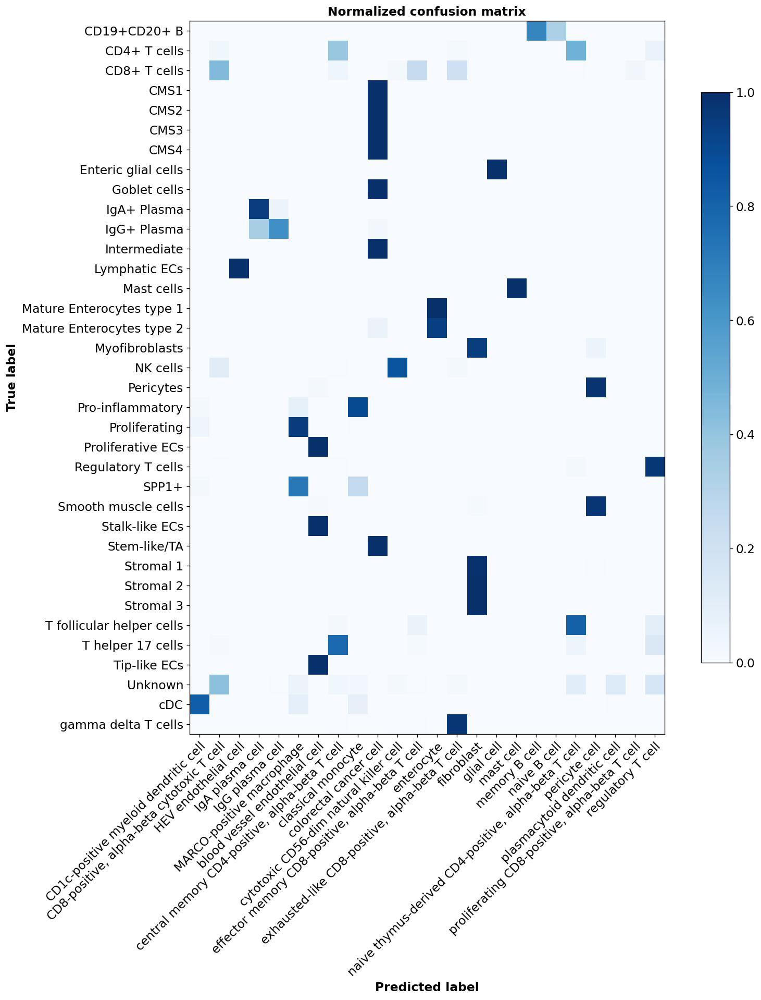

In [31]:
bc.tl.report(adata_pred=adata,
    method='author',
    analysis_name='standard',
    celltype='Cell_subtype', 
    name_prediction="dblabel",
    name_report="compare_annot_author", 
    verbose=True)


In [ ]:
bc.tl.report(adata_pred=adata,
    method='author',
    analysis_name='standard',
    celltype='Cell_subtype', 
    name_prediction="Cell_subtype_random",
    name_report="compare_annot_random", 
    verbose=True)



acc: 0.65
f1: 0.67


... storing 'Cell_type_dblabel' as categorical
... storing 'Cell_subtype_dblabel_lev2' as categorical
... storing 'Cell_subtype_dblabel_lev3' as categorical
... storing 'Cell_type_random' as categorical
... storing 'Cell_subtype_random' as categorical
... storing 'Cell_type_dblabel_random' as categorical
... storing 'Cell_subtype_dblabel_lev2_random' as categorical
... storing 'Cell_subtype_dblabel_lev3_random' as categorical


ami: 0.93
ari: 0.94
silhouette Cell_type_dblabel: 0.47
silhouette celltype1: 0.18
pair confusion matrix:
            0          1
0  2786646000    2711724
1    79584284  897273522


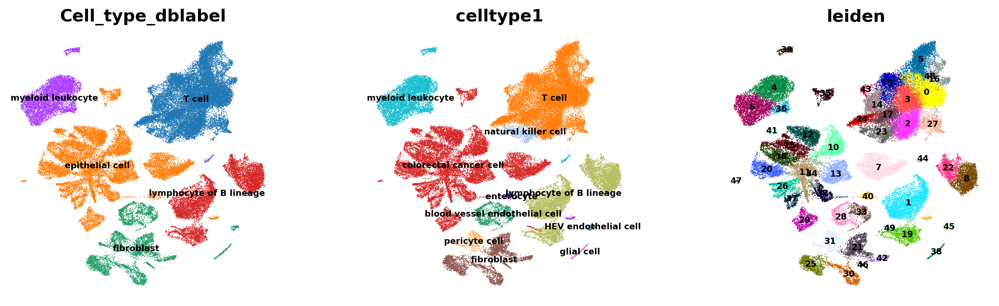

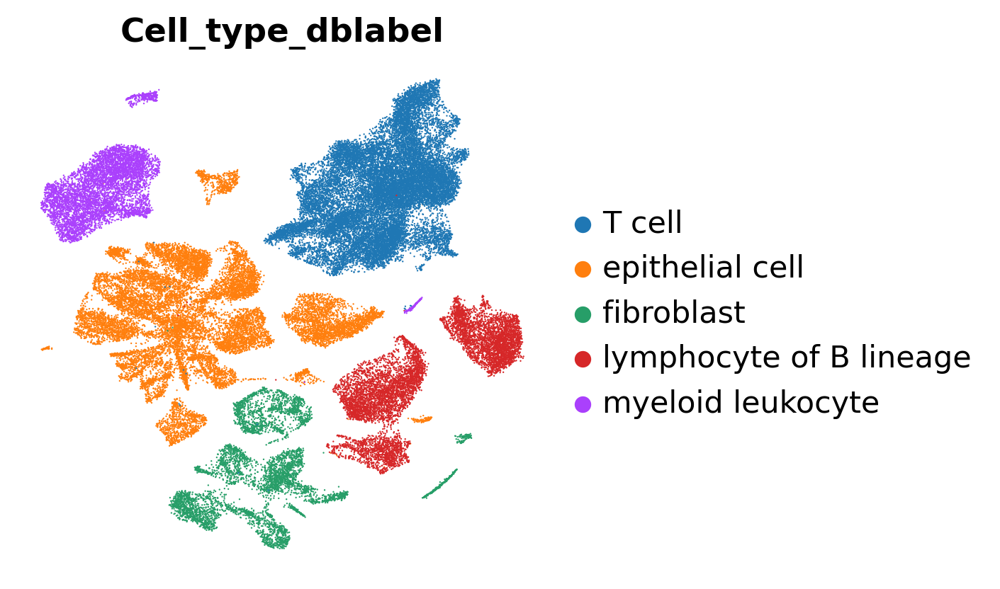

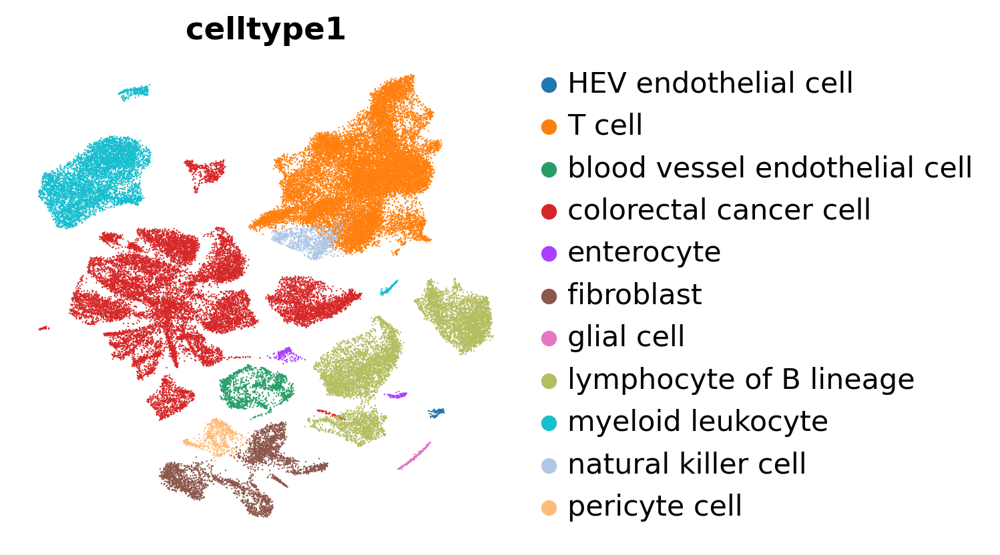

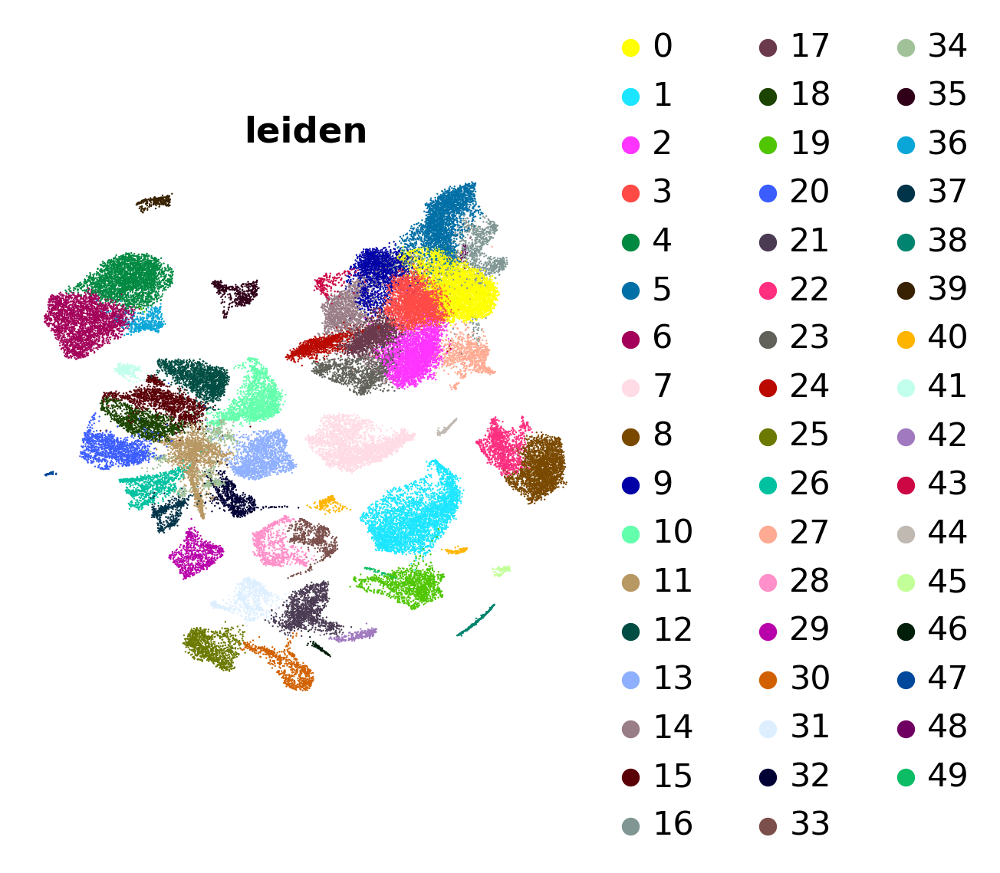

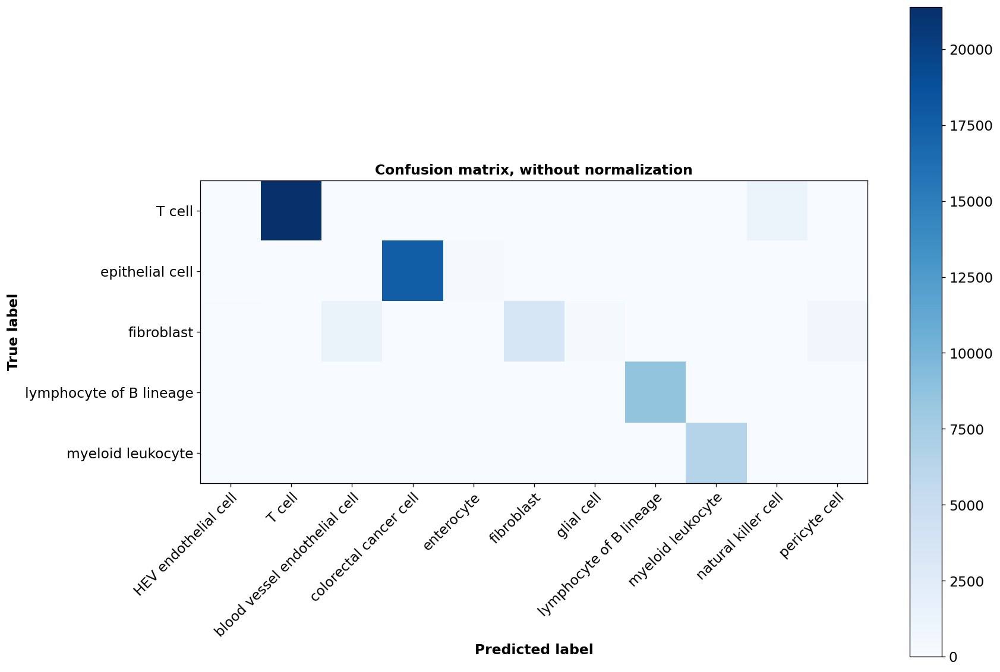

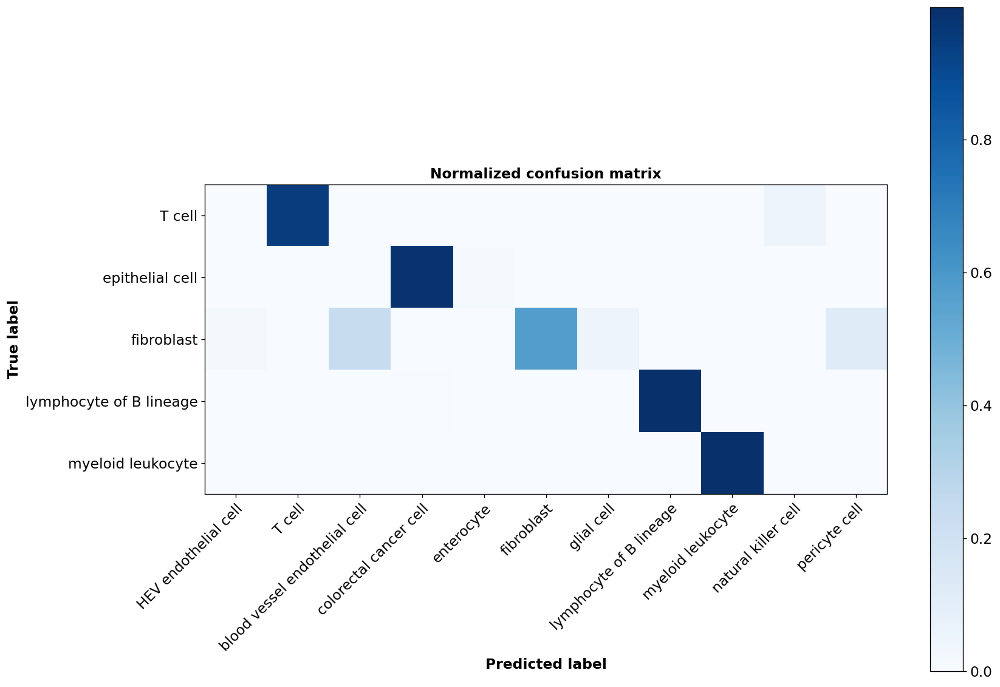

In [41]:
bc.tl.report(adata_pred=adata,
    method='author',
    analysis_name='standard',
    celltype='Cell_type_dblabel', 
    name_prediction="celltype1",
    name_report="compare_annot_lev1", 
    verbose=True)


acc: 0.26
f1: 0.26
ami: 0.0
ari: 0.0
silhouette Cell_type_dblabel: 0.47
silhouette Cell_type_dblabel_random: -0.0
pair confusion matrix:
            0          1
0  2066530824  722826900
1   722826900  254030906


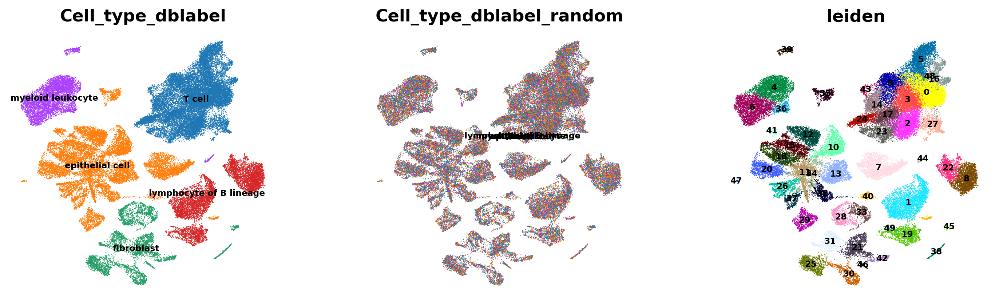

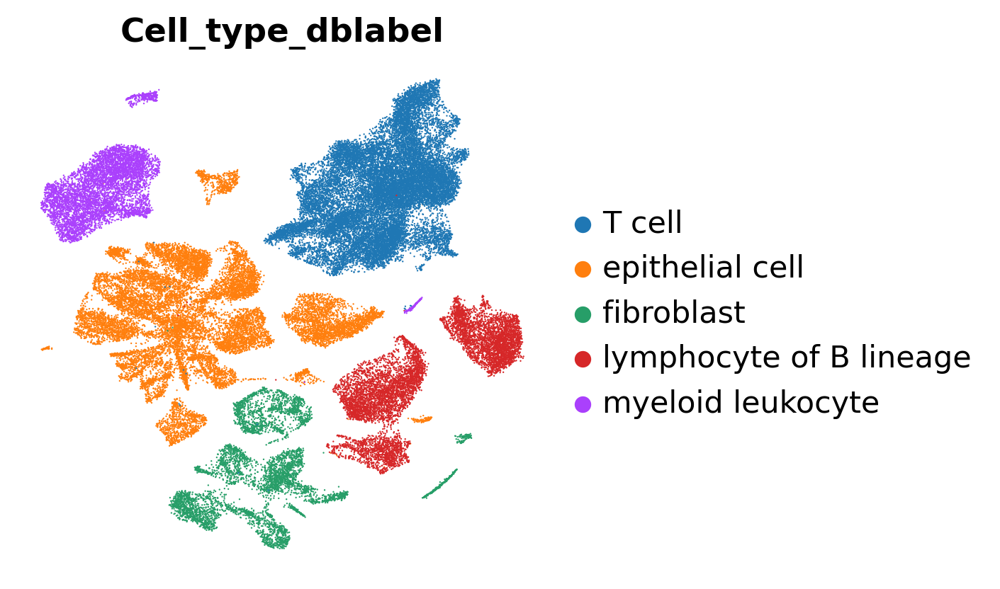

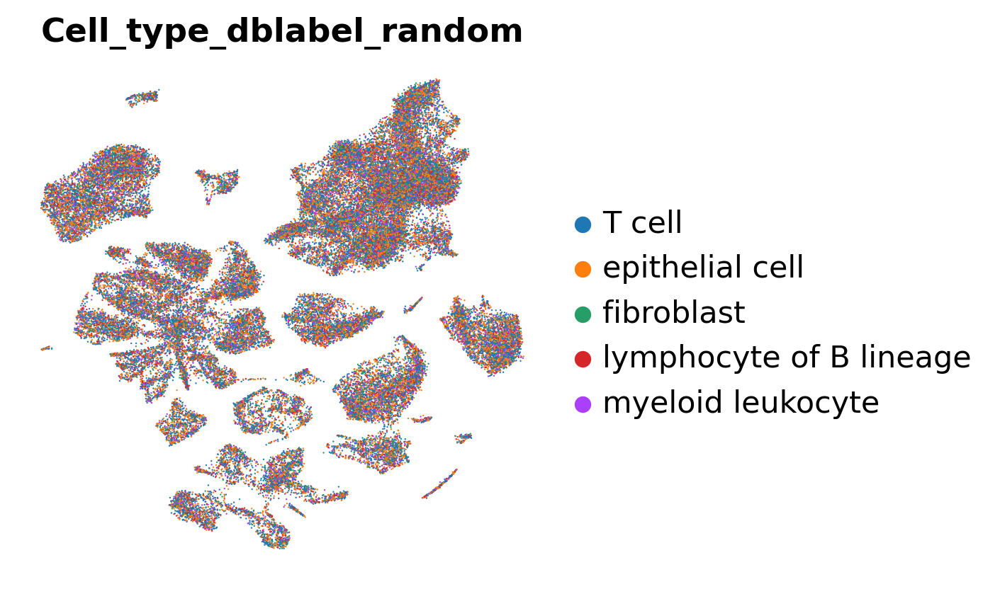

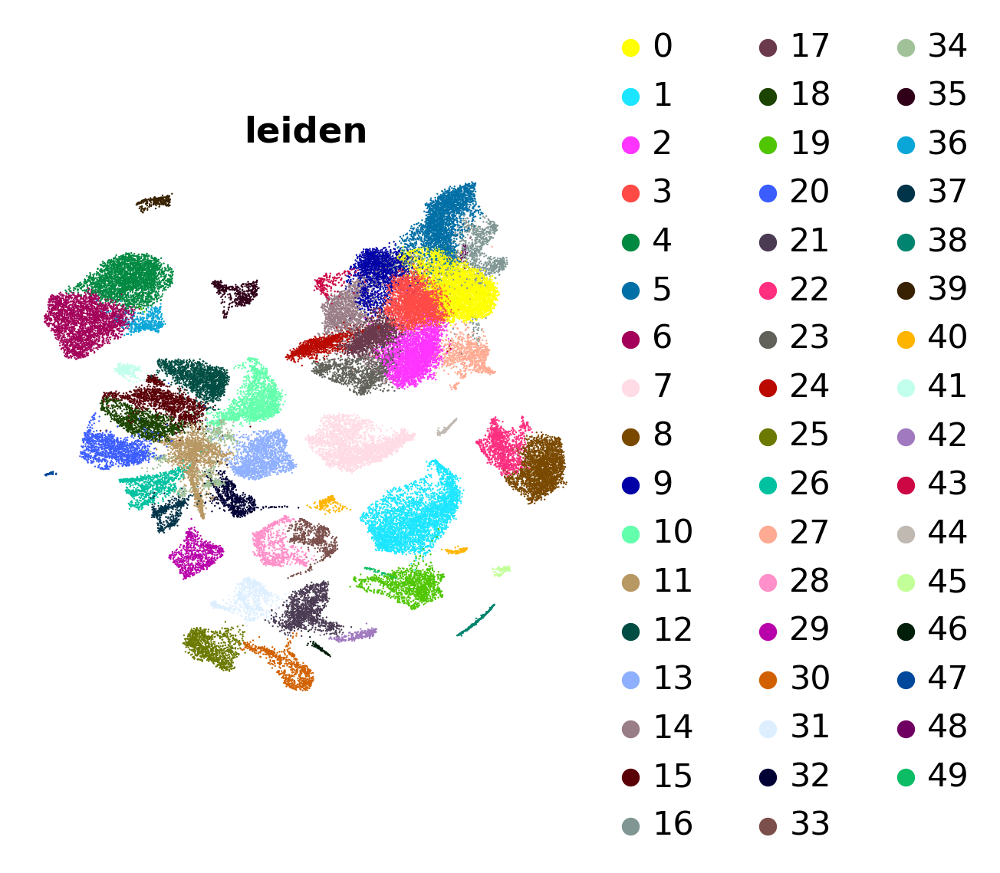

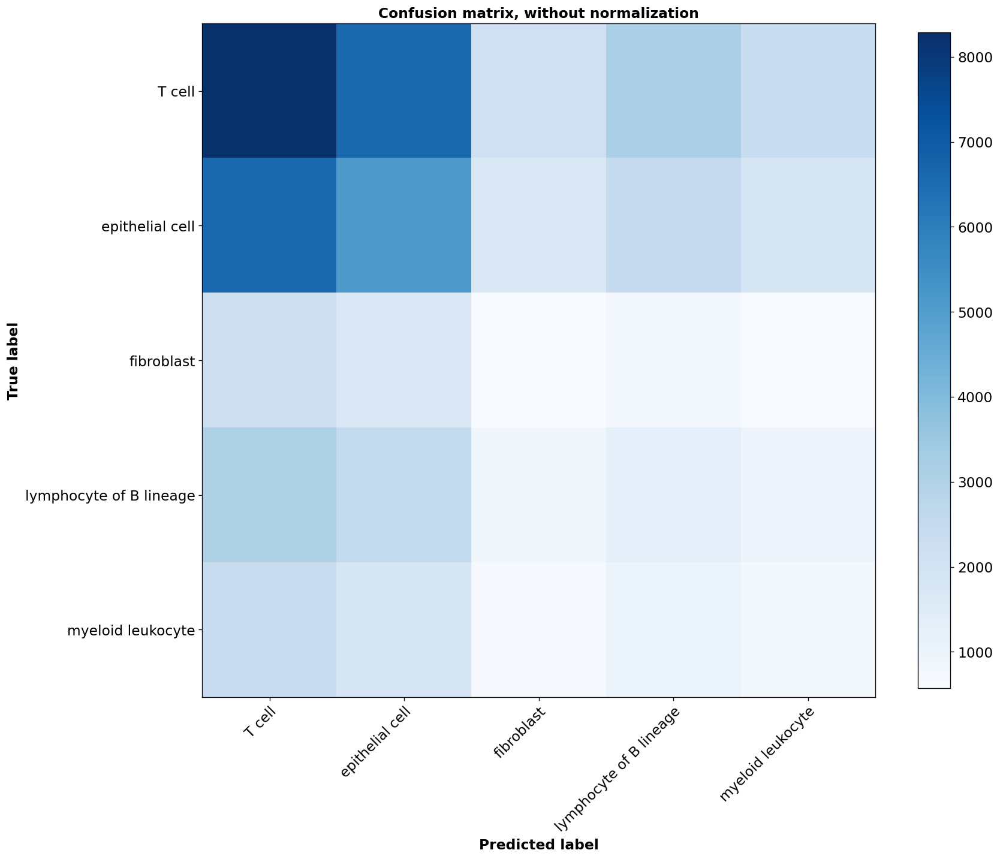

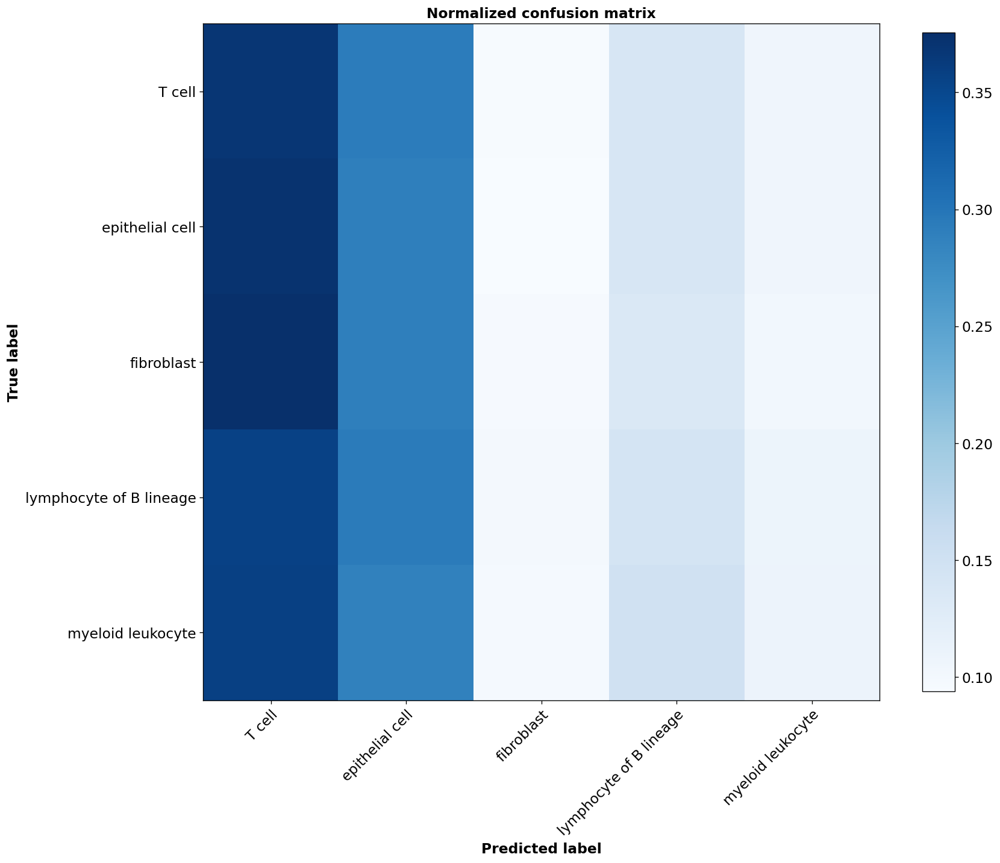

In [42]:
bc.tl.report(adata_pred=adata,
    method='author',
    analysis_name='standard',
    celltype='Cell_type_dblabel', 
    name_prediction="Cell_type_dblabel_random",
    name_report="compare_annot_lev1_random", 
    verbose=True)


In [ ]:
bc.tl.report(adata_pred=adata,
    method='author',
    analysis_name='standard',
    celltype='Cell_subtype_dblabel_lev2', 
    name_prediction="celltype2",
    name_report="compare_annot_lev2", 
    verbose=True)


acc: 0.12
f1: 0.12
ami: -0.0
ari: -0.0
silhouette Cell_subtype_dblabel_lev2: 0.05
silhouette Cell_subtype_dblabel_lev2_random: -0.06
pair confusion matrix:
            0          1
0  2887365884  410402506
1   410402506   58044634


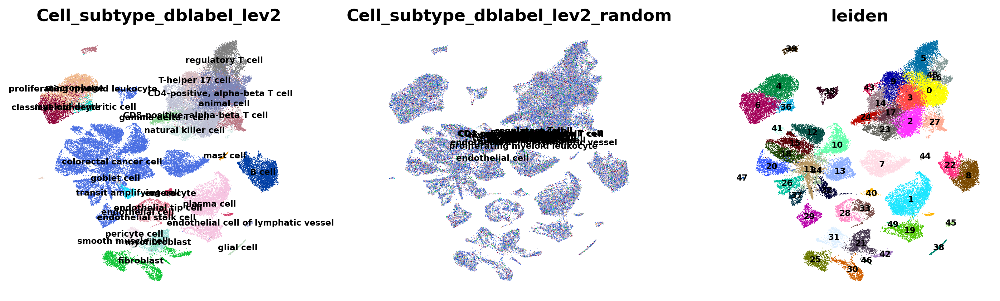

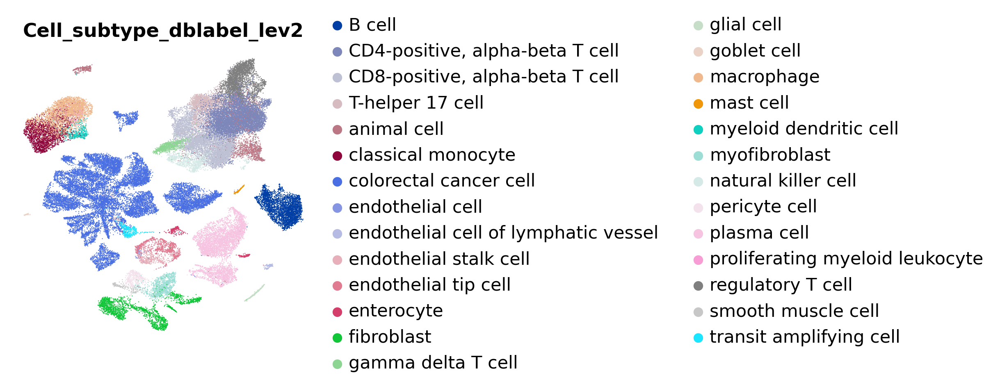

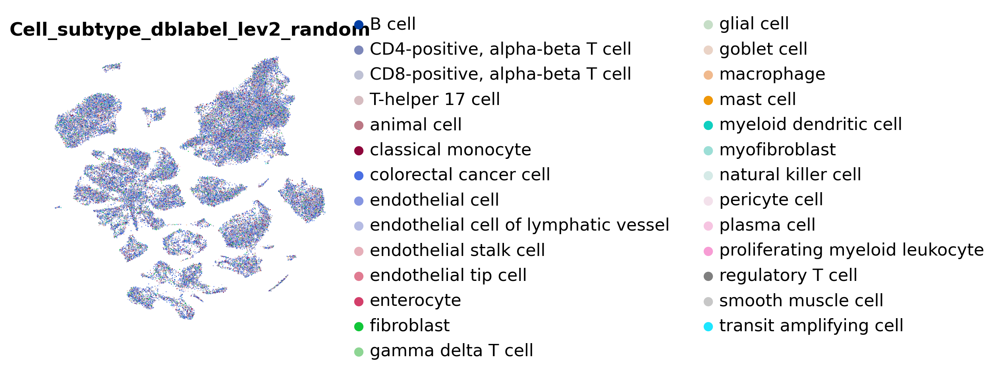

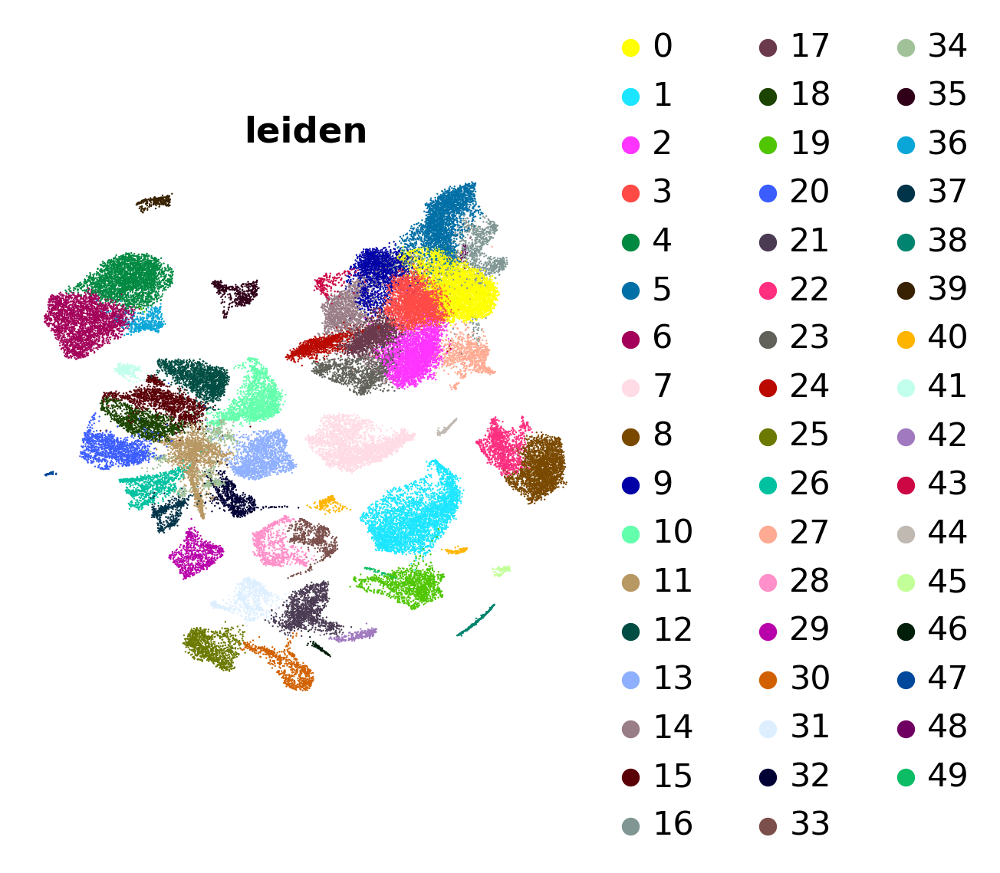

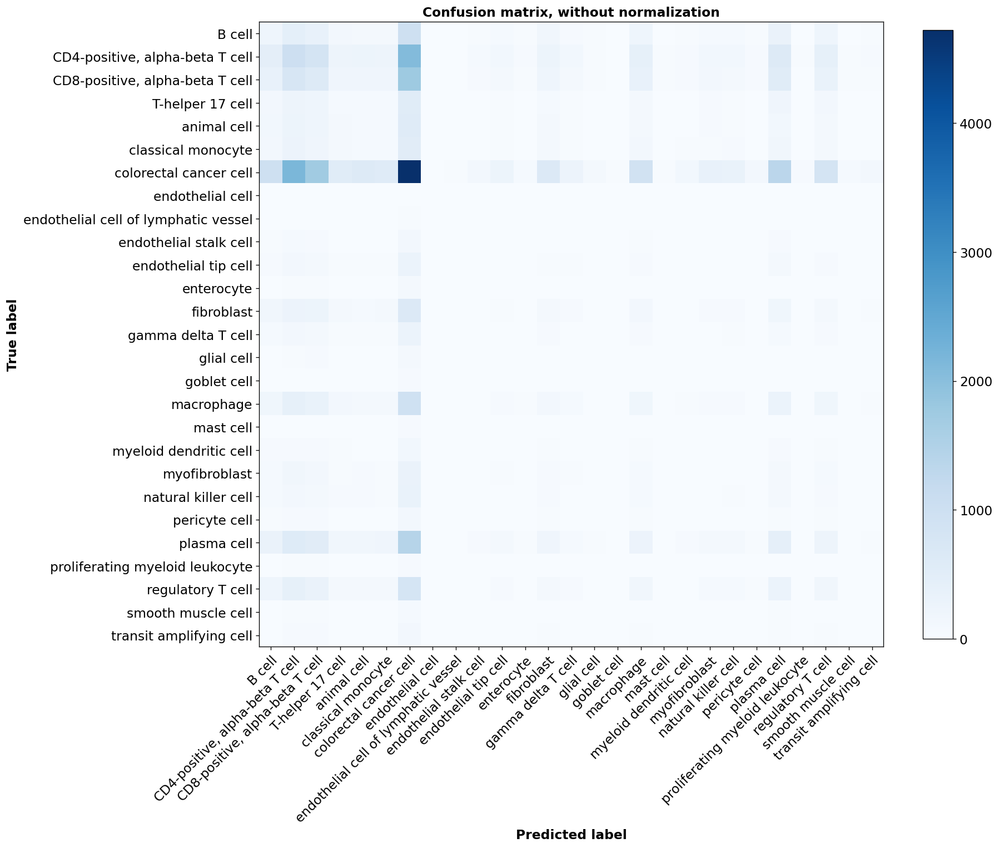

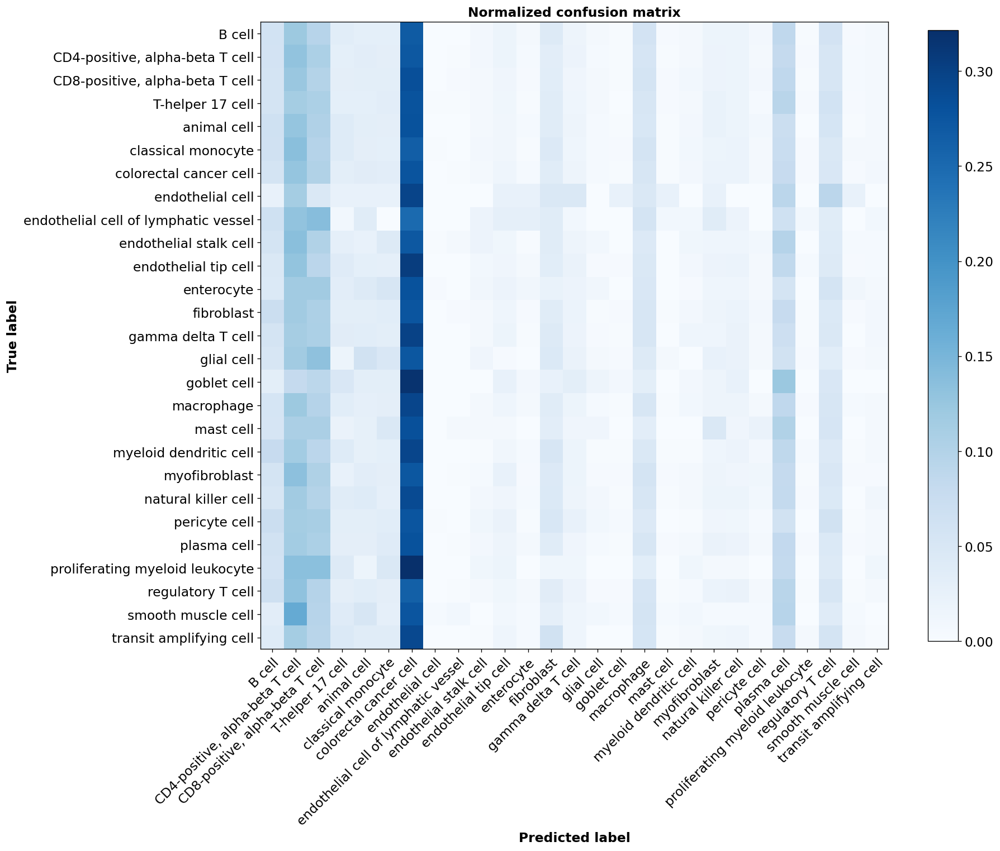

In [36]:
bc.tl.report(adata_pred=adata,
    method='author',
    analysis_name='standard',
    celltype='Cell_subtype_dblabel_lev2', 
    name_prediction="Cell_subtype_dblabel_lev2_random",
    name_report="compare_annot_lev2_random", 
    verbose=True)


In [ ]:
bc.tl.report(adata_pred=adata,
    method='author',
    analysis_name='standard',
    celltype='Cell_subtype_dblabel_lev3', 
    name_prediction="dblabel",
    name_report="compare_annot_lev3", 
    verbose=True)


acc: 0.12
f1: 0.12
ami: 0.0
ari: -0.0
silhouette Cell_subtype_dblabel_lev3: 0.02
silhouette Cell_subtype_dblabel_lev3_random: -0.05
pair confusion matrix:
            0          1
0  2922175616  395626420
1   395626420   52787074


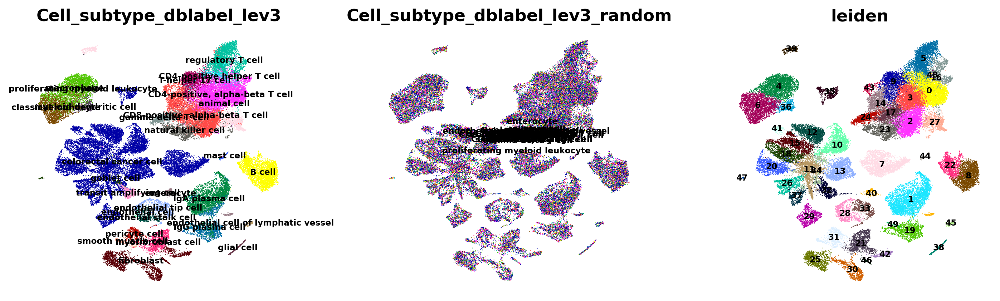

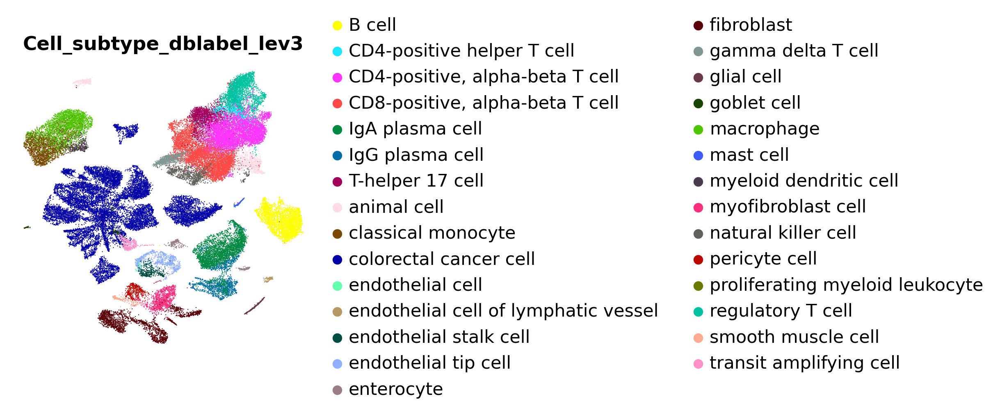

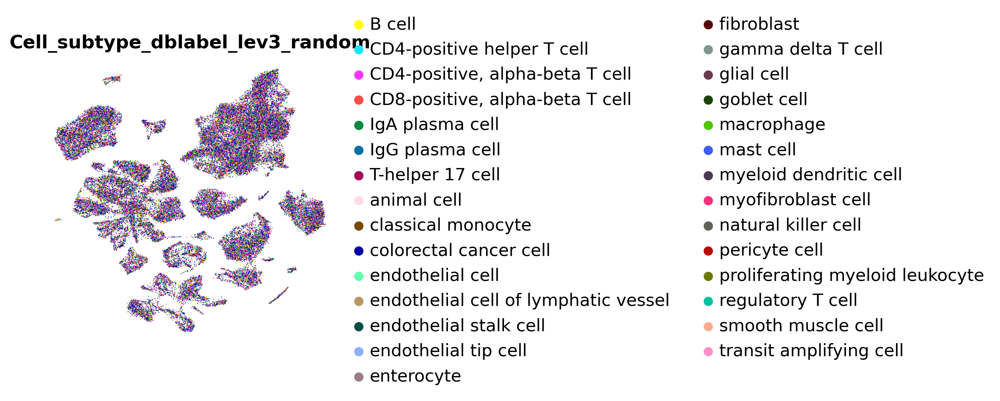

In [ ]:
bc.tl.report(adata_pred=adata,
    method='author',
    analysis_name='standard',
    celltype='Cell_subtype_dblabel_lev3', 
    name_prediction="Cell_subtype_dblabel_lev3_random",
    name_report="compare_annot_lev3_random", 
    verbose=True)


In [ ]:
! jupyter nbconvert --to html celltype_annotation_besca_updated.ipynb